In [1]:
# Add path to sys so that we can import functions from other folders
from re import L
import sys
import os
sys.path.append(r"C:\Users\tfarotimi\Documents\CEPAL\Inflation Forecasting\src")
sys.path.append(r"C:\Users\tfarotimi\Documents\CEPAL\Inflation Forecasting\lib")

# Import libraries
import pandas as pd
import numpy as np
import plotly.graph_objs as go
import plotly.offline as pyo
from plotly.subplots import make_subplots
#matplotlib 
import matplotlib.pyplot as plt
pyo.init_notebook_mode()

#import matplotlib.pyplot as plt
import seaborn as sns

# from tqdm import tqdm

from monthly_forecast_run import run_monthly_forecast
from excel_agg_forecast import create_aggregate_report
from excel_forecast_report import create_forecast_report


# from helper_functions import load_data, read_inflation_data, merge_exogenous_data
from dashboard import model_compare, r2_compare, error_compare
from residuals_analysis import analyze_residuals
from forecast import get_forecast 
import armagarch as ag

from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_squared_error, r2_score

from statsmodels.tsa.ar_model import AutoReg, ar_select_order
from statsmodels.tsa.statespace.sarimax import SARIMAX
from statsmodels.tsa.arima.model import ARIMA
from statsmodels.tsa.vector_ar.var_model import VAR
from statsmodels.tsa.statespace.varmax import VARMAX
from statsmodels.tsa.api import acf, graphics, pacf

from models import arima, sarimax, varmax, cnn_model, random_forest_w_lags
from model_search import run_models

from helper_functions import read_inflation_data
import pmdarima as pm

import importlib
import models
import helper_functions
import dashboard
import residuals_analysis
import forecast

#Reload modules to ensure that changes made to them are reflected in the notebook
importlib.reload(models)
importlib.reload(helper_functions)
importlib.reload(dashboard)
importlib.reload(residuals_analysis)
importlib.reload(forecast)

# Jupyter magic for inline plotting
%matplotlib inline

# Seaborn and matplotlib settings
sns.set_style("darkgrid")
pd.plotting.register_matplotlib_converters()
plt.rc("figure", figsize=(16, 6))
plt.rc("font", size=14)


In [2]:
#import all necessary modules and functions for notebook 

# from helper_functions import load_data, read_inflation_data, merge_exogenous_data

In [3]:
#filter warnings
import warnings
warnings.filterwarnings('ignore')


In [4]:
# # #set file path to Raw YoY Inflation File

INFL_DATA_FILE_NAME = r'V:\DAT\DATA\Precios\PRECIOS\Precios\BDP_a_01_IPC_GRAL_ind_y_var_Tope_Working_Copy.xlsm'

EXOG_FILE_NAME = r'C:\Users\tfarotimi\Documents\CEPAL\Inflation Forecasting\dat\Inflation_with_Exo_Vars.xlsx' 

SUR_data, CEN_data, CAR_data, REG_data = read_inflation_data(INFL_DATA_FILE_NAME)

all_data = {'SUR_data':SUR_data, 'CEN_data': CEN_data, 'CAR_data':CAR_data, 'REG_data':REG_data}



print(REG_data.keys())

dict_keys(['R01', 'R02', 'R07', 'SUR10', 'CEN09', 'CEN10', 'CAR13'])


In [5]:
# all_data_pkl = r'C:\Users\tfarotimi\Documents\CEPAL\Inflation Forecasting\nb\all_data.pkl'

In [6]:
# # Write each data set in each region to a separate tab in an excel file 
# #write pkl file to excel file
# from pandas import ExcelWriter
# #import xlsx writer

# output_excel_file = r'C:\Users\tfarotimi\Documents\CEPAL\Inflation Forecasting\nb\all_data.xlsx'

# import pickle
# import pandas as pd

# # Function to write contents of each key in a pkl object to an excel file
# def pkl_to_excel(pkl_file, excel_file):
#     with open(pkl_file, 'rb') as f:
#         all_data = pickle.load(f)

#         # Create a Pandas Excel writer using the default engine
#         with pd.ExcelWriter(excel_file) as writer:
#             sheets_written = 0
#             for item in all_data.keys():
#                 for key in all_data[item]:
#                     # Convert the content to a DataFrame
#                     df = pd.DataFrame(all_data[item][key])
#                     # Only write non-empty DataFrames
#                     if not df.empty:
#                         df.to_excel(writer, sheet_name=key)
#                         sheets_written += 1
#             # If no sheets were written, add a dummy sheet
#             if sheets_written == 0:
#                 pd.DataFrame({'Info': ['No data available']}).to_excel(writer, sheet_name='Empty')

# # Example usage
# pkl_to_excel(all_data_pkl, output_excel_file)



In [7]:
#warnings
warnings.filterwarnings('ignore')


In [8]:
#import pickle  
import pickle

In [9]:
# #save into file i can reuse later
# # with open('all_data.pkl', 'wb') as f:
# #     pickle.dump(all_data, f)#load the data from the file
# #load the data from the file
# with open('all_data.pkl', 'rb') as f:
#     all_data = pickle.load(f)

In [10]:
# REG_data = all_data['REG_data']
# SUR_data = all_data['SUR_data']

In [11]:
CEN_data['MEX'].tail()

,YoY Increase Inflation
Period,
2025-01-01,3.585040
2025-02-01,3.773910
2025-03-01,3.801141
2025-04-01,3.933421
2025-05-01,4.420000


In [12]:
all_data

{'SUR_data': {'ARG':             YoY Increase Inflation
  Period                            
  1990-01-01             8240.470913
  1990-02-01            11879.067323
  1990-03-01            19981.565177
  1990-04-01            16680.905360
  1990-05-01            10795.104989
  ...                            ...
  2025-01-01               89.575015
  2025-02-01               68.570150
  2025-03-01               57.036129
  2025-04-01               47.735021
  2025-05-01               43.500000
  
  [425 rows x 1 columns],
  'BOL':             YoY Increase Inflation
  Period                            
  1990-01-01               17.205487
  1990-02-01               16.459247
  1990-03-01               15.912444
  1990-04-01               16.143173
  1990-05-01               16.056577
  ...                            ...
  2025-01-01               12.034367
  2025-02-01               13.223088
  2025-03-01               14.633914
  2025-04-01               15.005067
  2025-05-01        

In [13]:
#LIMIT EVERY DATASET IN REG_data to start from 2000-01-01
for region in all_data.keys():
    for key in all_data[region].keys():
        all_data[region][key] = all_data[region][key][all_data[region][key].index >= '2010-01-01']



In [14]:
REG_data

{'R01':             YoY Increase Inflation
 Period                            
 2010-01-01                1.588689
 2010-02-01                1.858725
 2010-03-01                2.046909
 2010-04-01                2.000860
 2010-05-01                1.947697
 ...                            ...
 2025-01-01                3.990051
 2025-02-01                4.236800
 2025-03-01                4.388701
 2025-04-01                4.401827
 2025-05-01                4.414650
 
 [183 rows x 1 columns],
 'R02':             YoY Increase Inflation
 Period                            
 2010-01-01                1.497190
 2010-02-01                1.750225
 2010-03-01                1.941341
 2010-04-01                1.877145
 2010-05-01                1.819252
 ...                            ...
 2025-01-01                4.004240
 2025-02-01                4.258420
 2025-03-01                4.409456
 2025-04-01                4.424529
 2025-05-01                4.469132
 
 [183 rows x 1 column

Running forecasts in parallel...


  0%|          | 0/7 [00:00<?, ?it/s]

Began processing country: R01
Processing R01 with model random_forest_w_lags
Training  random_forest_w_lags for  R01
✅ Overlap: 171 timestamps match
✅ Merge successful. Shape: (171, 24)
Training data after featuring engineering:  (171, 24)
X_shape: (159, 41) Y shape: (159, 1)
Training Random Forest model with RandomizedSearchCV...


Random search fits:   0%|          | 0/375 [00:00<?, ?it/s]

  0%|          | 0/375 [00:00<?, ?it/s]

Random Forest model training time: 26.87 seconds
Best parameters found: {'n_estimators': 150, 'min_samples_split': 5, 'min_samples_leaf': 4, 'max_features': 0.7, 'max_depth': 300, 'bootstrap': False}
Best score (RMSE): 0.8972392250237732
Training updated model with best parameters...for intermediate steps
Best Random Forest model training time: 1.28 seconds
Fold 1: train=36, test=36
Fold 2: train=72, test=36
Fold 3: train=108, test=36
Fold 4: train=144, test=3


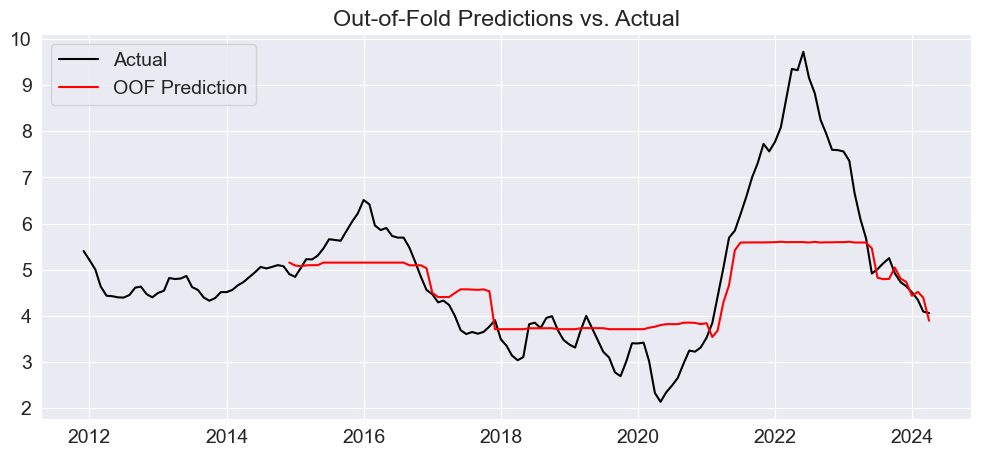

Out-of-fold RMSE: 1.2341


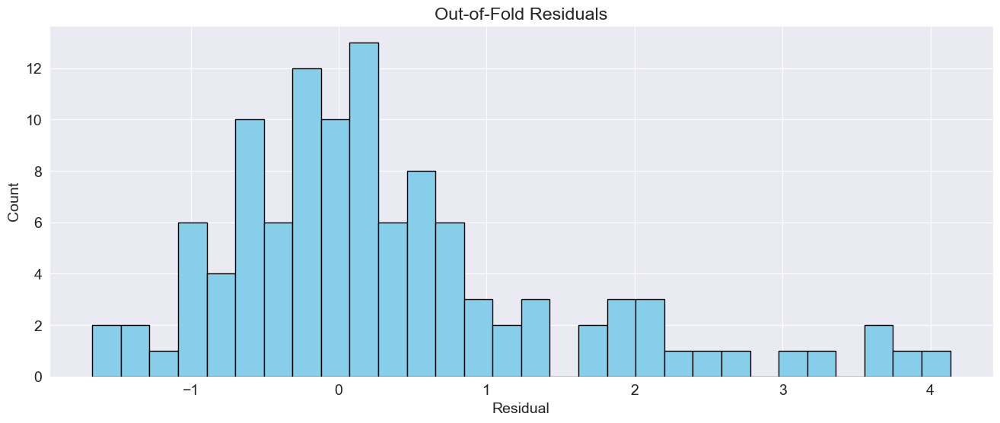

Testing different tree counts with tqdm progress bar...


Tree count sweep:   0%|          | 0/8 [00:00<?, ?it/s]

150 trees → avg CV RMSE = 0.914
300 trees → avg CV RMSE = 0.903
Δ RMSE from previous: 0.01133
500 trees → avg CV RMSE = 0.913
Δ RMSE from previous: 0.00991
800 trees → avg CV RMSE = 0.908
Δ RMSE from previous: 0.00447
1000 trees → avg CV RMSE = 0.908
Δ RMSE from previous: 0.00000
No improvement count: 1
1200 trees → avg CV RMSE = 0.906
Δ RMSE from previous: 0.00192
1400 trees → avg CV RMSE = 0.907
Δ RMSE from previous: 0.00087
No improvement count: 1
1500 trees → avg CV RMSE = 0.907
Δ RMSE from previous: 0.00016
No improvement count: 2
Early stopping triggered at 1500 trees.

✅ Best number of trees: 300 with avg CV RMSE = 0.903


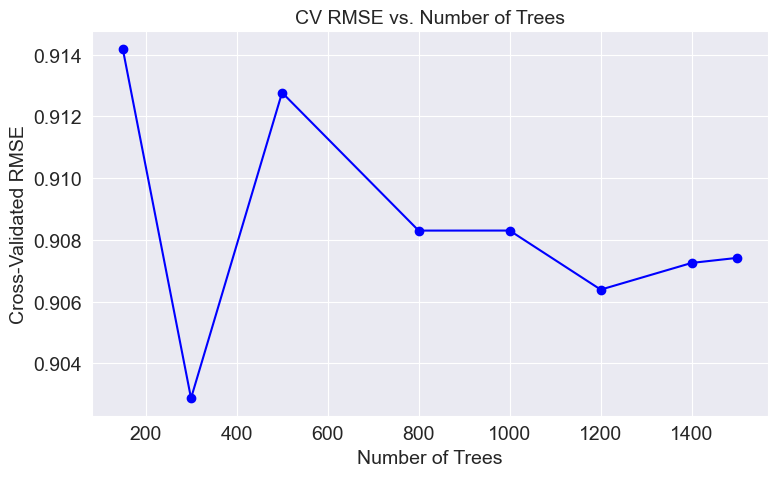

Training final Random Forest model with best parameters...
Final model training time: 0.49 seconds


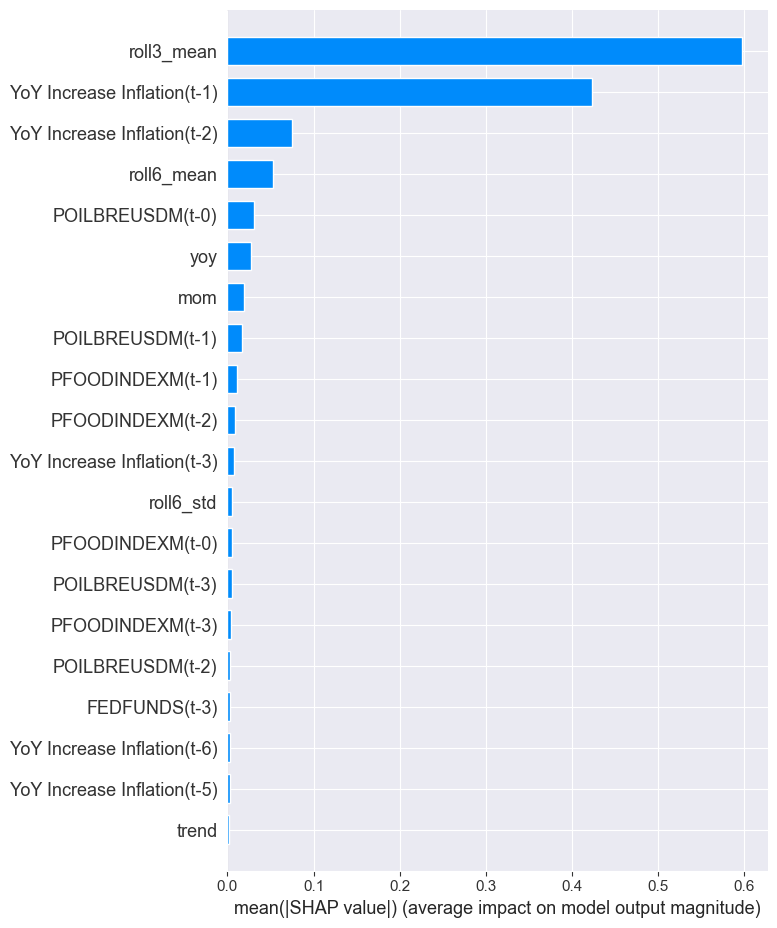

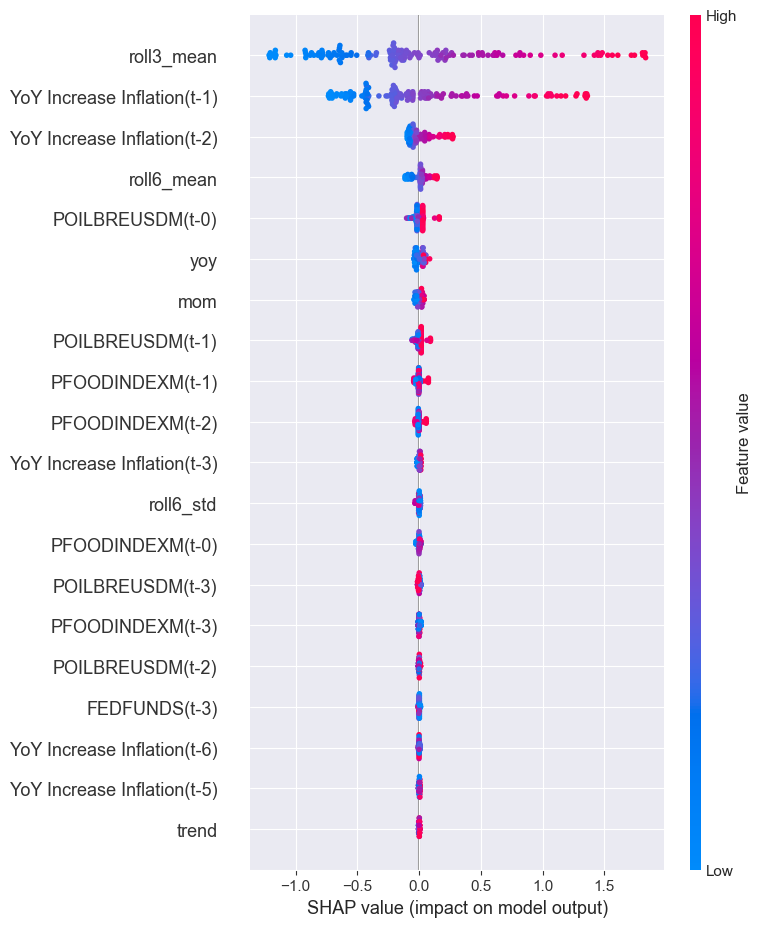

Training set bias (mean residual): -0.0001
Running recursive forecast with feature generation...
Forecast [4.0302999  4.07329861 4.37415242 4.42100861 4.16886382 4.0472293
 4.10102221 4.15578587 4.02553034 4.03057579 4.14779117 4.55181801]
Recursive forecast time: 0.08 seconds
rmse_ts: 0.16889373544618608
y hat ts: [[4.0302999 ]
 [4.07329861]
 [4.37415242]
 [4.42100861]
 [4.16886382]
 [4.0472293 ]
 [4.10102221]
 [4.15578587]
 [4.02553034]
 [4.03057579]
 [4.14779117]
 [4.55181801]]
Formatting results...
RMSE: 0.1689
MAPE: 3.52%
R²: -0.358, R²_bar: -0.100
fine after formatting results
exog_data shape (397, 12)
last index of exog_data 2025-04-01 00:00:00
LAST FULL_DATA INDEX 2025-04-01 00:00:00
future_start 2025-05-01 00:00:00
(154, 42) all _data, exogenous lagged data merged successfully.
full_data shape after feature engineering:  (154, 42)
future exog shape: (12, 12)
target Pickle object created
Pickle object created
forecast_month: 2025-05-01 00:00:00
future_exog index dtype: datetime

Bootstrapping: 100%|██████████| 100/100 [01:39<00:00,  1.01it/s]


finished bootstrapping 
conf ints
lower_bounds: [3.99441649 3.90403113 3.80682623 3.72590672 3.65971782 3.59369079
 3.54569676 3.52458053 3.49889499 3.39507193 3.33109037 3.29632042]
upper_bounds: [5.13921528 5.24961641 5.58410752 5.77868882 6.05629607 6.23119281
 6.51053517 6.63676303 6.83196897 7.03007674 7.23463094 7.40267438]


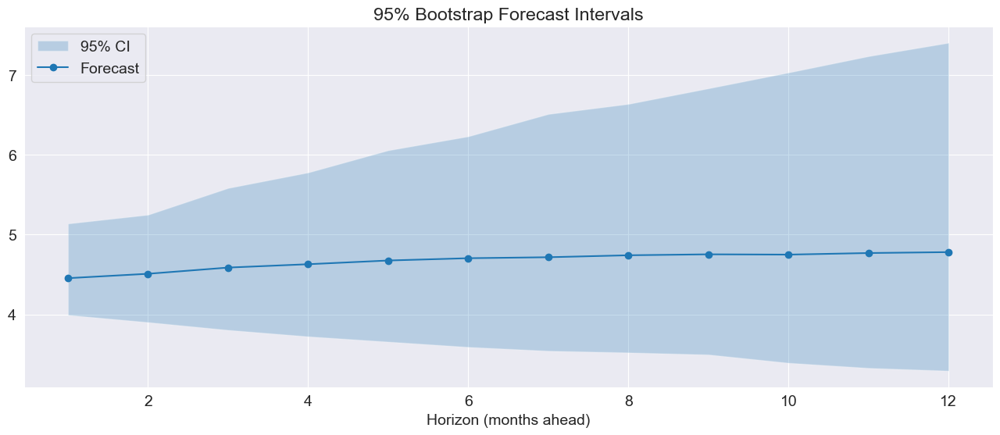

RMSE: 0.2512
MAPE: 4.98%
R²: -2.005, R²_bar: -0.100
all_Y: 2024-06-01    4.321802
2024-07-01    4.572360
2024-08-01    4.251646
2024-09-01    4.112848
2024-10-01    4.244782
2024-11-01    4.273684
2024-12-01    4.172064
2025-01-01    3.990051
2025-02-01    4.236800
2025-03-01    4.388701
2025-04-01    4.401827
2025-05-01    4.414650
2025-05-01    4.535653
2025-06-01    4.654917
2025-07-01    4.679315
2025-08-01    4.721764
2025-09-01    4.802963
2025-10-01    4.844234
2025-11-01    4.867667
2025-12-01    4.889967
2026-01-01    4.881924
2026-02-01    4.889393
2026-03-01    4.882864
2026-04-01    4.874740
dtype: float64
forecast: 2025-05-01    4.535653
2025-06-01    4.654917
2025-07-01    4.679315
2025-08-01    4.721764
2025-09-01    4.802963
2025-10-01    4.844234
2025-11-01    4.867667
2025-12-01    4.889967
2026-01-01    4.881924
2026-02-01    4.889393
2026-03-01    4.882864
2026-04-01    4.874740
Name: predicted_mean, dtype: float64


 14%|█▍        | 1/7 [03:30<21:00, 210.13s/it]

Forecast object saved to  reports\\2025/June/2025-06-20/R01/Random Forest w/ Lags/R01 _Inflation_203031_forecast_object.json
Completed processing R01 with model random_forest_w_lags
Began processing country: R02
Processing R02 with model random_forest_w_lags
Training  random_forest_w_lags for  R02
✅ Overlap: 171 timestamps match
✅ Merge successful. Shape: (171, 24)
Training data after featuring engineering:  (171, 24)
X_shape: (159, 41) Y shape: (159, 1)
Training Random Forest model with RandomizedSearchCV...


Random search fits:   0%|          | 0/375 [00:00<?, ?it/s]

  0%|          | 0/375 [00:00<?, ?it/s]

Random Forest model training time: 22.93 seconds
Best parameters found: {'n_estimators': 150, 'min_samples_split': 5, 'min_samples_leaf': 4, 'max_features': 0.7, 'max_depth': 300, 'bootstrap': False}
Best score (RMSE): 0.8802534683079795
Training updated model with best parameters...for intermediate steps
Best Random Forest model training time: 1.37 seconds
Fold 1: train=36, test=36
Fold 2: train=72, test=36
Fold 3: train=108, test=36
Fold 4: train=144, test=3


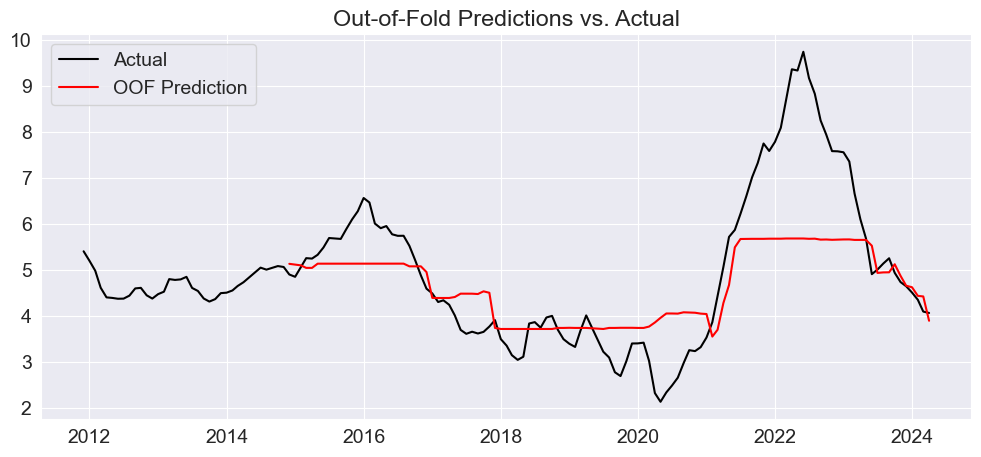

Out-of-fold RMSE: 1.2279


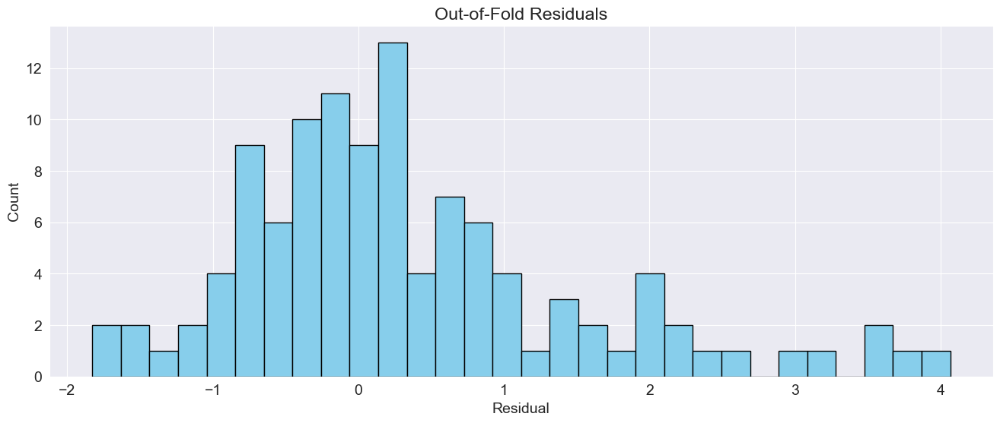

Testing different tree counts with tqdm progress bar...


Tree count sweep:   0%|          | 0/8 [00:00<?, ?it/s]

150 trees → avg CV RMSE = 0.897
300 trees → avg CV RMSE = 0.883
Δ RMSE from previous: 0.01380
500 trees → avg CV RMSE = 0.887
Δ RMSE from previous: 0.00404
800 trees → avg CV RMSE = 0.890
Δ RMSE from previous: 0.00239
1000 trees → avg CV RMSE = 0.891
Δ RMSE from previous: 0.00150
1200 trees → avg CV RMSE = 0.893
Δ RMSE from previous: 0.00203
1400 trees → avg CV RMSE = 0.895
Δ RMSE from previous: 0.00146
1500 trees → avg CV RMSE = 0.894
Δ RMSE from previous: 0.00075
No improvement count: 1

✅ Best number of trees: 300 with avg CV RMSE = 0.883


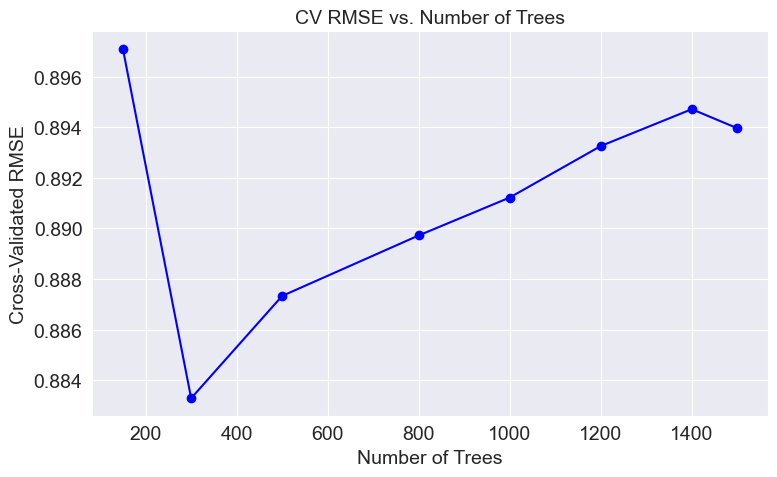

Training final Random Forest model with best parameters...
Final model training time: 0.47 seconds


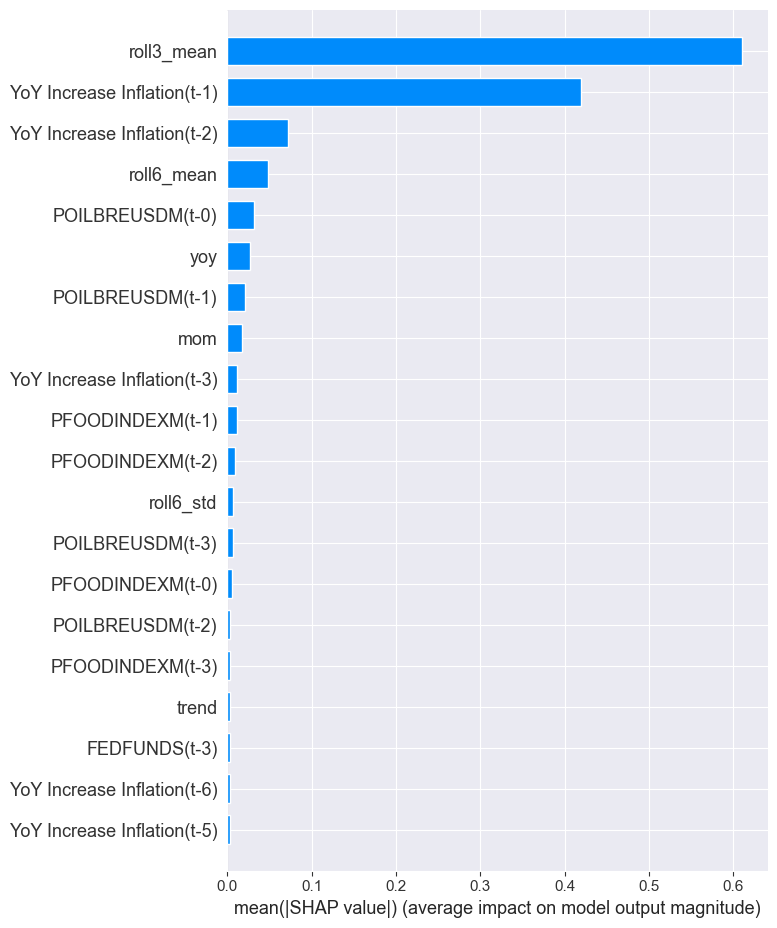

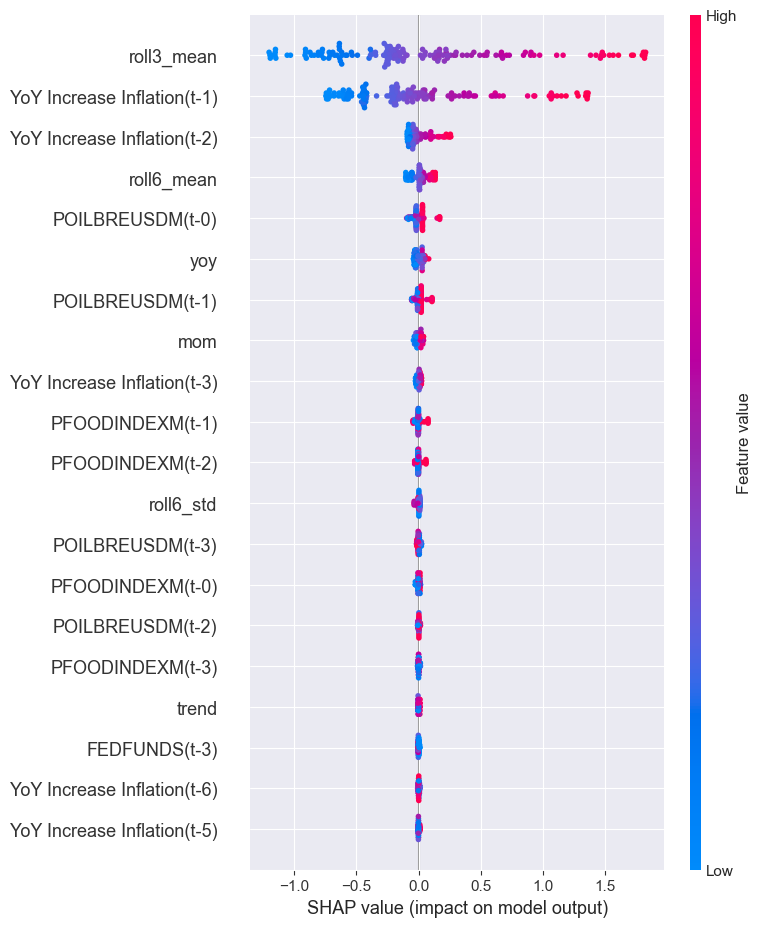

Training set bias (mean residual): -0.0012
Running recursive forecast with feature generation...
Forecast [4.0432429  4.0963875  4.3851905  4.42557897 4.19135209 4.06594114
 4.11877405 4.25729905 4.04461839 4.04253077 4.16854922 4.56182045]
Recursive forecast time: 0.04 seconds
rmse_ts: 0.16984461969843792
y hat ts: [[4.0432429 ]
 [4.0963875 ]
 [4.3851905 ]
 [4.42557897]
 [4.19135209]
 [4.06594114]
 [4.11877405]
 [4.25729905]
 [4.04461839]
 [4.04253077]
 [4.16854922]
 [4.56182045]]
Formatting results...
RMSE: 0.1698
MAPE: 3.62%
R²: -0.331, R²_bar: -0.100
fine after formatting results
exog_data shape (397, 12)
last index of exog_data 2025-04-01 00:00:00
LAST FULL_DATA INDEX 2025-04-01 00:00:00
future_start 2025-05-01 00:00:00
(154, 42) all _data, exogenous lagged data merged successfully.
full_data shape after feature engineering:  (154, 42)
future exog shape: (12, 12)
target Pickle object created
Pickle object created
forecast_month: 2025-05-01 00:00:00
future_exog index dtype: datetim

Bootstrapping: 100%|██████████| 100/100 [00:48<00:00,  2.05it/s]


finished bootstrapping 
conf ints
lower_bounds: [3.95651375 3.89745279 3.74396325 3.63152686 3.55320824 3.51556237
 3.47316124 3.46202498 3.38654457 3.3120937  3.28408676 3.27545774]
upper_bounds: [5.18663361 5.26818674 5.53924099 5.75379846 5.79673993 5.90515105
 6.12807596 6.17805519 6.43802565 6.54842863 6.70759868 7.06331151]


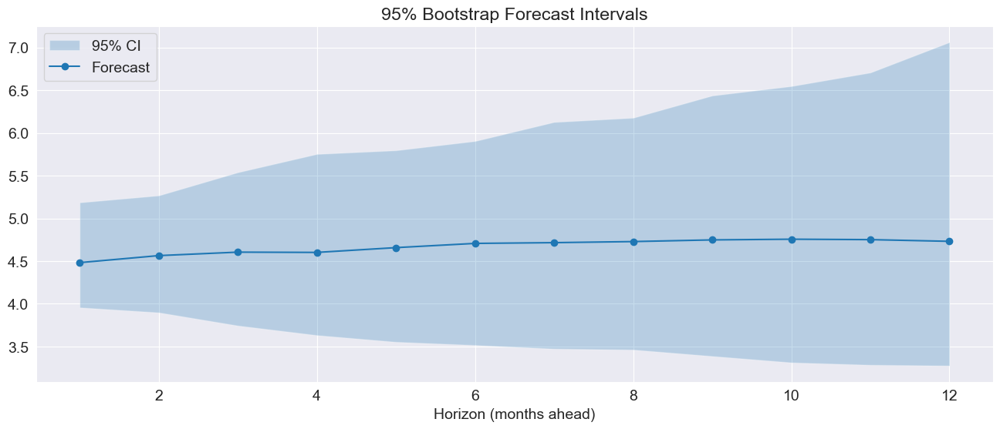

RMSE: 0.2583
MAPE: 5.10%
R²: -2.078, R²_bar: -0.100
all_Y: 2024-06-01    4.334371
2024-07-01    4.591726
2024-08-01    4.261039
2024-09-01    4.125421
2024-10-01    4.263838
2024-11-01    4.295262
2024-12-01    4.188433
2025-01-01    4.004240
2025-02-01    4.258420
2025-03-01    4.409456
2025-04-01    4.424529
2025-05-01    4.469132
2025-05-01    4.542565
2025-06-01    4.633717
2025-07-01    4.649778
2025-08-01    4.680401
2025-09-01    4.756143
2025-10-01    4.789254
2025-11-01    4.800586
2025-12-01    4.809645
2026-01-01    4.813735
2026-02-01    4.822652
2026-03-01    4.822357
2026-04-01    4.797888
dtype: float64
forecast: 2025-05-01    4.542565
2025-06-01    4.633717
2025-07-01    4.649778
2025-08-01    4.680401
2025-09-01    4.756143
2025-10-01    4.789254
2025-11-01    4.800586
2025-12-01    4.809645
2026-01-01    4.813735
2026-02-01    4.822652
2026-03-01    4.822357
2026-04-01    4.797888
Name: predicted_mean, dtype: float64


 29%|██▊       | 2/7 [06:00<14:35, 175.16s/it]

Forecast object saved to  reports\\2025/June/2025-06-20/R02/Random Forest w/ Lags/R02 _Inflation_203302_forecast_object.json
Completed processing R02 with model random_forest_w_lags
Began processing country: R07
Processing R07 with model random_forest_w_lags
Training  random_forest_w_lags for  R07
✅ Overlap: 171 timestamps match
✅ Merge successful. Shape: (171, 24)
Training data after featuring engineering:  (171, 24)
X_shape: (159, 41) Y shape: (159, 1)
Training Random Forest model with RandomizedSearchCV...


Random search fits:   0%|          | 0/375 [00:00<?, ?it/s]

  0%|          | 0/375 [00:00<?, ?it/s]

Random Forest model training time: 19.75 seconds
Best parameters found: {'n_estimators': 100, 'min_samples_split': 5, 'min_samples_leaf': 2, 'max_features': 0.5, 'max_depth': 600, 'bootstrap': False}
Best score (RMSE): 0.7714293587167006
Training updated model with best parameters...for intermediate steps
Best Random Forest model training time: 1.05 seconds
Fold 1: train=36, test=36
Fold 2: train=72, test=36
Fold 3: train=108, test=36
Fold 4: train=144, test=3


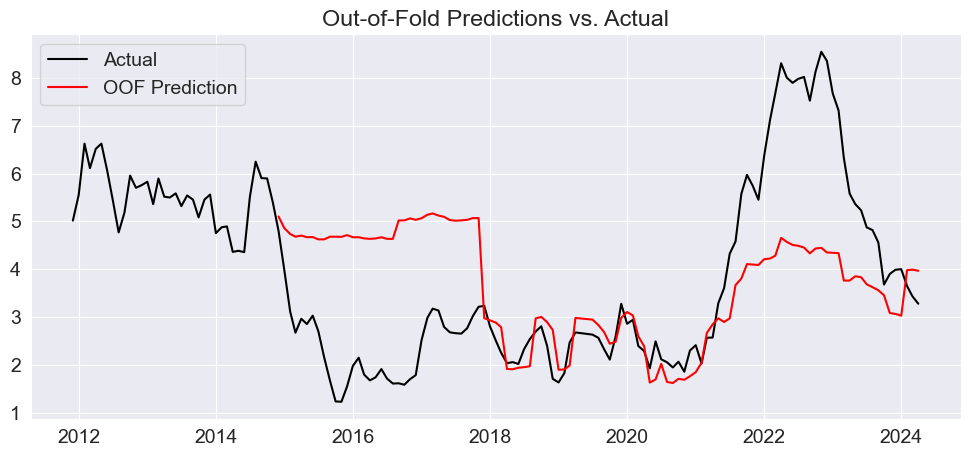

Out-of-fold RMSE: 1.9836


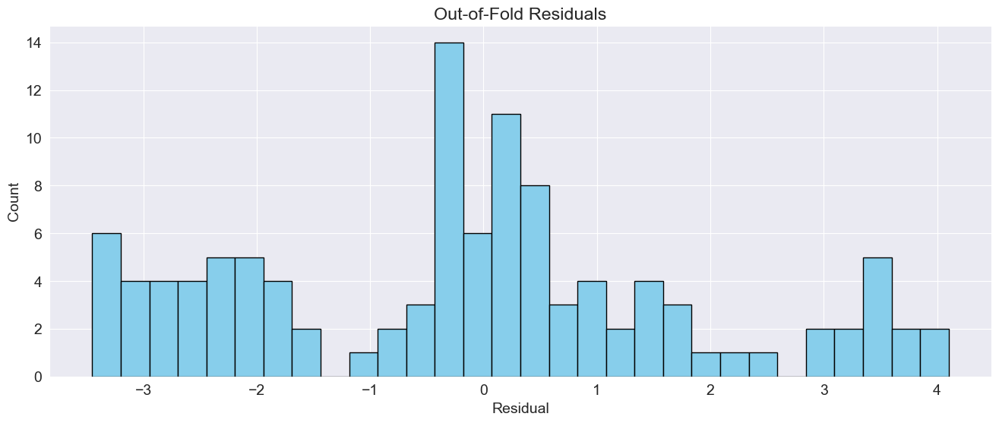

Testing different tree counts with tqdm progress bar...


Tree count sweep:   0%|          | 0/8 [00:00<?, ?it/s]

150 trees → avg CV RMSE = 1.058
300 trees → avg CV RMSE = 1.048
Δ RMSE from previous: 0.00996
500 trees → avg CV RMSE = 1.047
Δ RMSE from previous: 0.00119
800 trees → avg CV RMSE = 1.049
Δ RMSE from previous: 0.00184
1000 trees → avg CV RMSE = 1.044
Δ RMSE from previous: 0.00484
1200 trees → avg CV RMSE = 1.043
Δ RMSE from previous: 0.00095
No improvement count: 1
1400 trees → avg CV RMSE = 1.044
Δ RMSE from previous: 0.00140
1500 trees → avg CV RMSE = 1.043
Δ RMSE from previous: 0.00105

✅ Best number of trees: 1200 with avg CV RMSE = 1.043


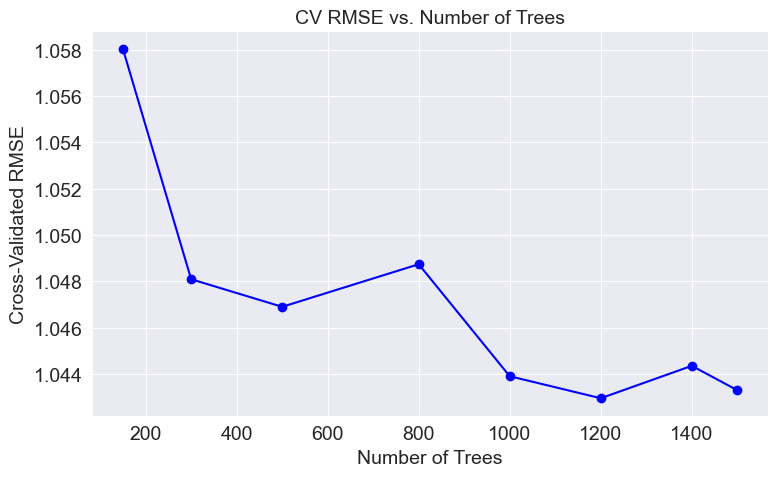

Training final Random Forest model with best parameters...
Final model training time: 2.00 seconds


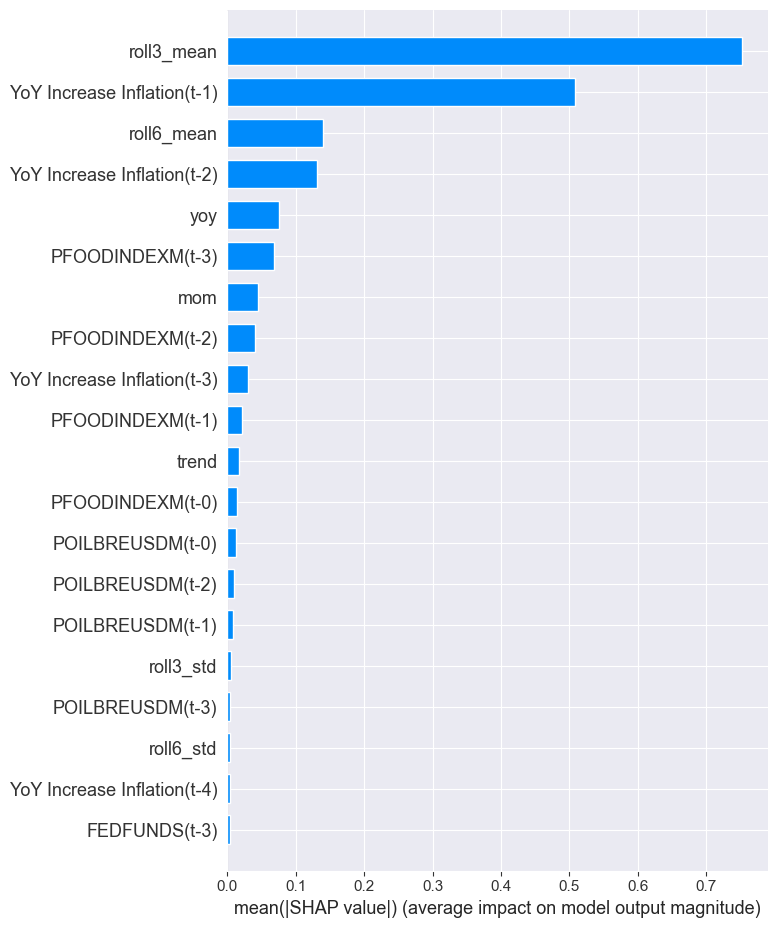

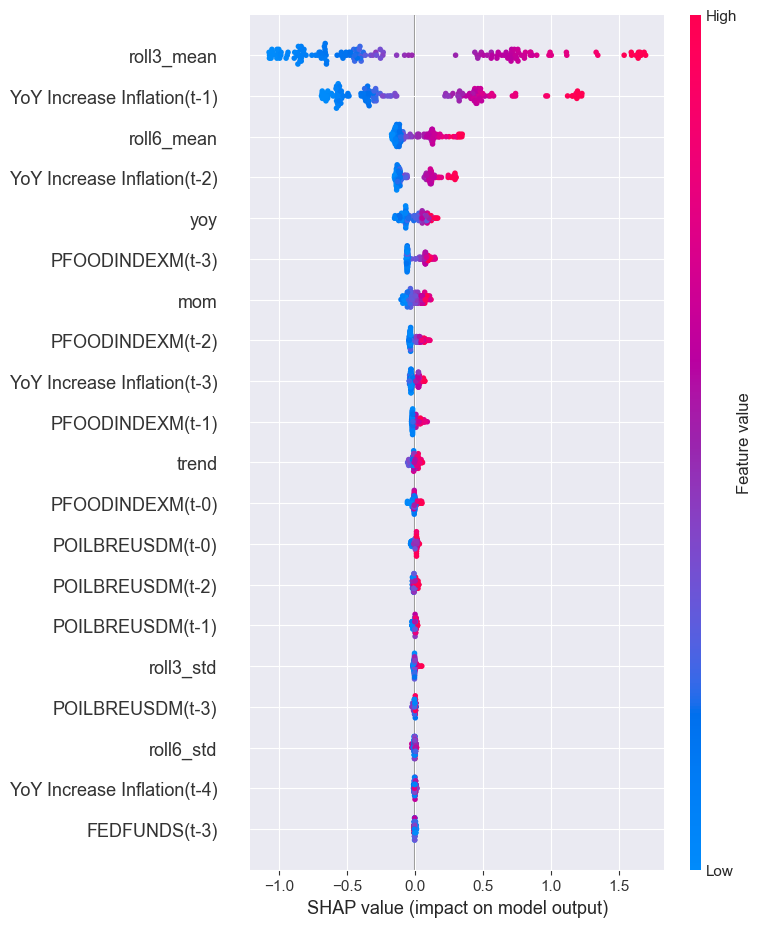

Training set bias (mean residual): 0.0004
Running recursive forecast with feature generation...
Forecast [3.49055201 3.56295891 3.56163414 3.54453894 3.57478067 3.47213107
 3.34889745 3.28364551 3.29473103 3.26209377 3.06631319 3.02983203]
Recursive forecast time: 0.11 seconds
rmse_ts: 0.5174166071351929
y hat ts: [[3.49055201]
 [3.56295891]
 [3.56163414]
 [3.54453894]
 [3.57478067]
 [3.47213107]
 [3.34889745]
 [3.28364551]
 [3.29473103]
 [3.26209377]
 [3.06631319]
 [3.02983203]]
Formatting results...
RMSE: 0.5174
MAPE: 16.78%
R²: -1.523, R²_bar: -0.100
fine after formatting results
exog_data shape (397, 12)
last index of exog_data 2025-04-01 00:00:00
LAST FULL_DATA INDEX 2025-04-01 00:00:00
future_start 2025-05-01 00:00:00
(154, 42) all _data, exogenous lagged data merged successfully.
full_data shape after feature engineering:  (154, 42)
future exog shape: (12, 12)
target Pickle object created
Pickle object created
forecast_month: 2025-05-01 00:00:00
future_exog index dtype: datetime

Bootstrapping: 100%|██████████| 100/100 [02:10<00:00,  1.31s/it]


finished bootstrapping 
conf ints
lower_bounds: [2.50101201 2.47166677 2.50611093 2.5571246  2.50912157 2.51939079
 2.60908625 2.62127483 2.65792753 2.65472547 2.65298835 2.64815538]
upper_bounds: [3.90853001 4.31441479 5.03626724 5.19720225 5.37844952 5.47812877
 5.69008477 5.7990168  5.90818495 5.96266038 6.05172398 6.0773252 ]


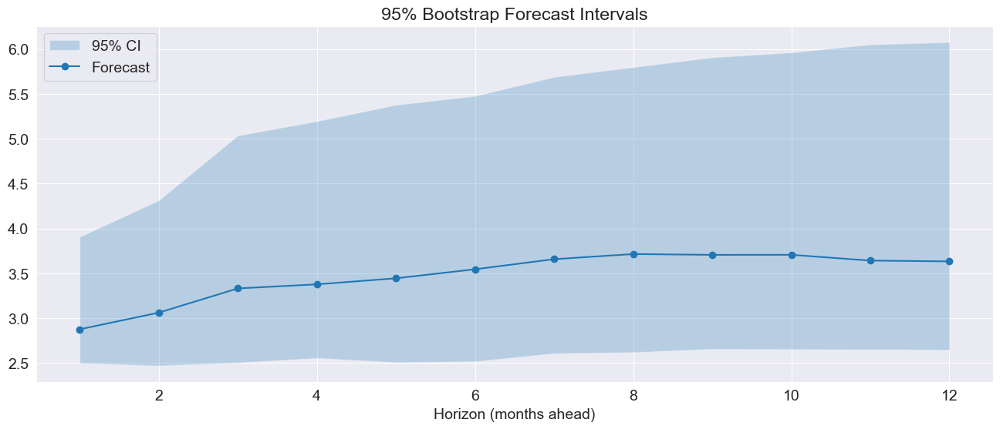

RMSE: 0.4887
MAPE: 15.45%
R²: -1.251, R²_bar: -0.100
all_Y: 2024-05-01    3.350762
2024-06-01    3.307937
2024-07-01    3.010200
2024-08-01    3.493969
2024-09-01    3.098681
2024-10-01    2.707670
2024-11-01    2.533116
2024-12-01    2.851681
2025-01-01    2.840311
2025-02-01    2.484910
2025-03-01    2.706914
2025-04-01    2.562305
2025-05-01    2.882713
2025-06-01    3.132048
2025-07-01    3.423212
2025-08-01    3.492851
2025-09-01    3.557149
2025-10-01    3.601410
2025-11-01    3.641977
2025-12-01    3.672956
2026-01-01    3.671808
2026-02-01    3.677608
2026-03-01    3.660058
2026-04-01    3.647655
dtype: float64
forecast: 2025-05-01    2.882713
2025-06-01    3.132048
2025-07-01    3.423212
2025-08-01    3.492851
2025-09-01    3.557149
2025-10-01    3.601410
2025-11-01    3.641977
2025-12-01    3.672956
2026-01-01    3.671808
2026-02-01    3.677608
2026-03-01    3.660058
2026-04-01    3.647655
Name: predicted_mean, dtype: float64


 43%|████▎     | 3/7 [10:08<13:52, 208.19s/it]

Forecast object saved to  reports\\2025/June/2025-06-20/R07/Random Forest w/ Lags/R07 _Inflation_203709_forecast_object.json
Completed processing R07 with model random_forest_w_lags
Began processing country: SUR10
Processing SUR10 with model random_forest_w_lags
Training  random_forest_w_lags for  SUR10
✅ Overlap: 171 timestamps match
✅ Merge successful. Shape: (171, 24)
Training data after featuring engineering:  (171, 24)
X_shape: (159, 41) Y shape: (159, 1)
Training Random Forest model with RandomizedSearchCV...


Random search fits:   0%|          | 0/375 [00:00<?, ?it/s]

  0%|          | 0/375 [00:00<?, ?it/s]

Random Forest model training time: 21.22 seconds
Best parameters found: {'n_estimators': 150, 'min_samples_split': 5, 'min_samples_leaf': 4, 'max_features': 0.7, 'max_depth': 300, 'bootstrap': False}
Best score (RMSE): 0.8027579573265241
Training updated model with best parameters...for intermediate steps
Best Random Forest model training time: 1.29 seconds
Fold 1: train=36, test=36
Fold 2: train=72, test=36
Fold 3: train=108, test=36
Fold 4: train=144, test=3


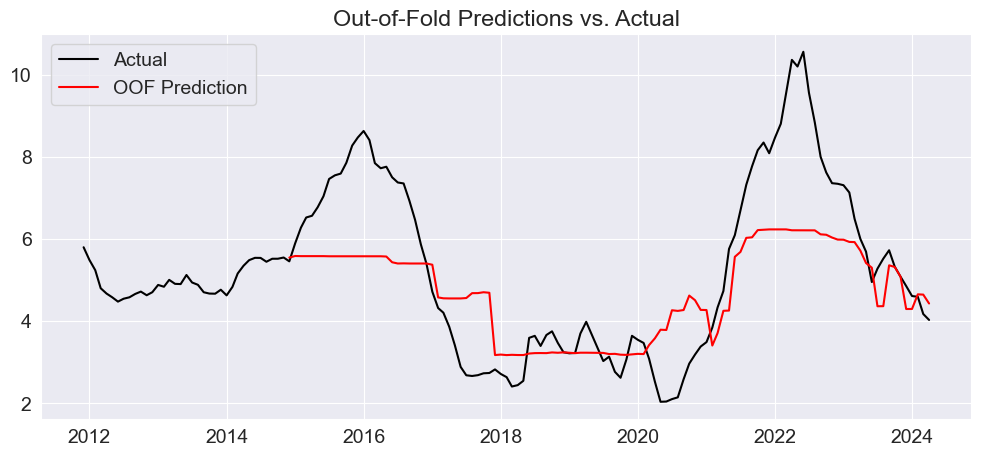

Out-of-fold RMSE: 1.5587


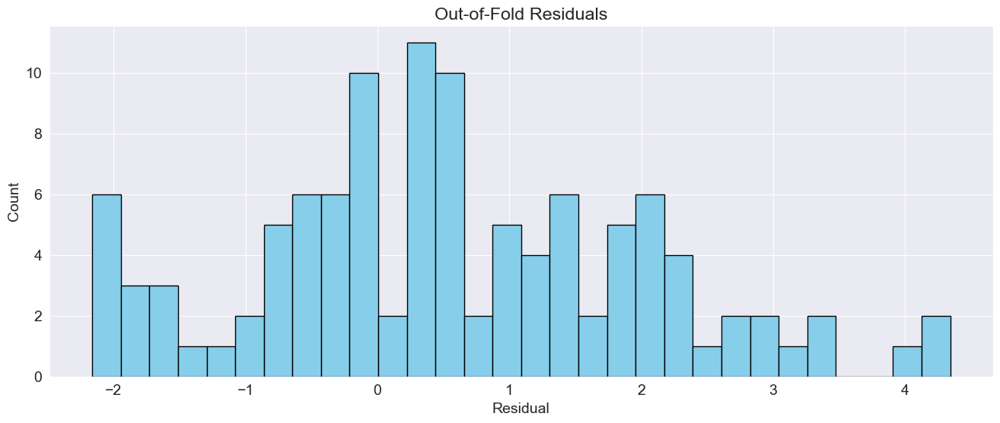

Testing different tree counts with tqdm progress bar...


Tree count sweep:   0%|          | 0/8 [00:00<?, ?it/s]

150 trees → avg CV RMSE = 1.343
300 trees → avg CV RMSE = 1.337
Δ RMSE from previous: 0.00611
500 trees → avg CV RMSE = 1.327
Δ RMSE from previous: 0.01033
800 trees → avg CV RMSE = 1.332
Δ RMSE from previous: 0.00540
1000 trees → avg CV RMSE = 1.328
Δ RMSE from previous: 0.00386
1200 trees → avg CV RMSE = 1.325
Δ RMSE from previous: 0.00266
1400 trees → avg CV RMSE = 1.327
Δ RMSE from previous: 0.00182
1500 trees → avg CV RMSE = 1.326
Δ RMSE from previous: 0.00174

✅ Best number of trees: 1200 with avg CV RMSE = 1.325


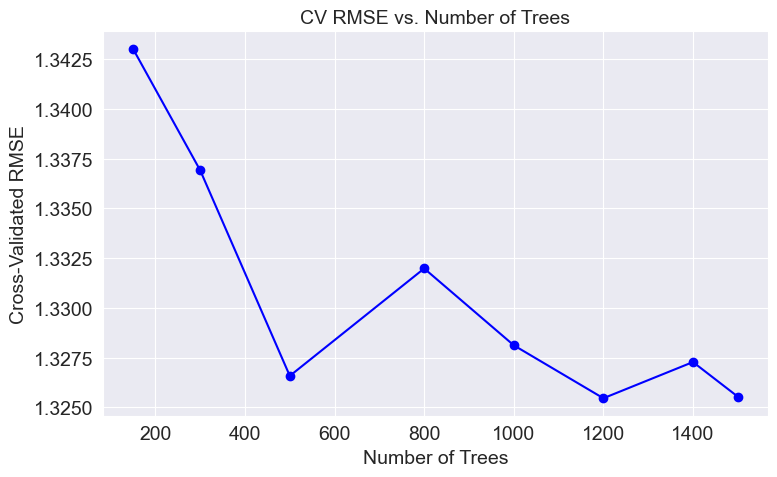

Training final Random Forest model with best parameters...
Final model training time: 2.06 seconds


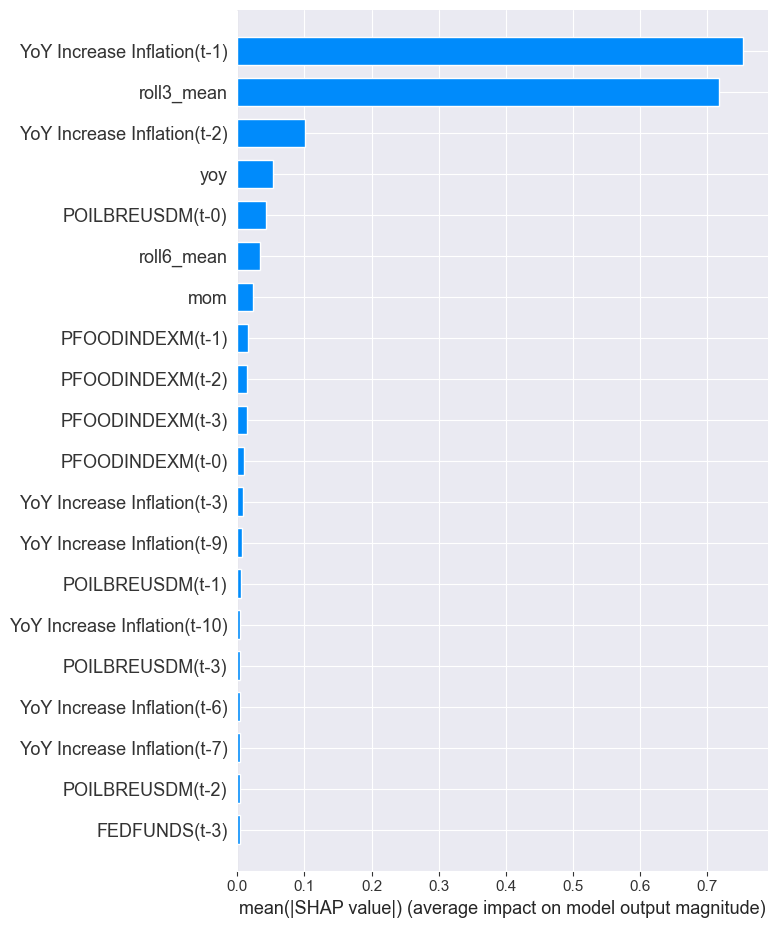

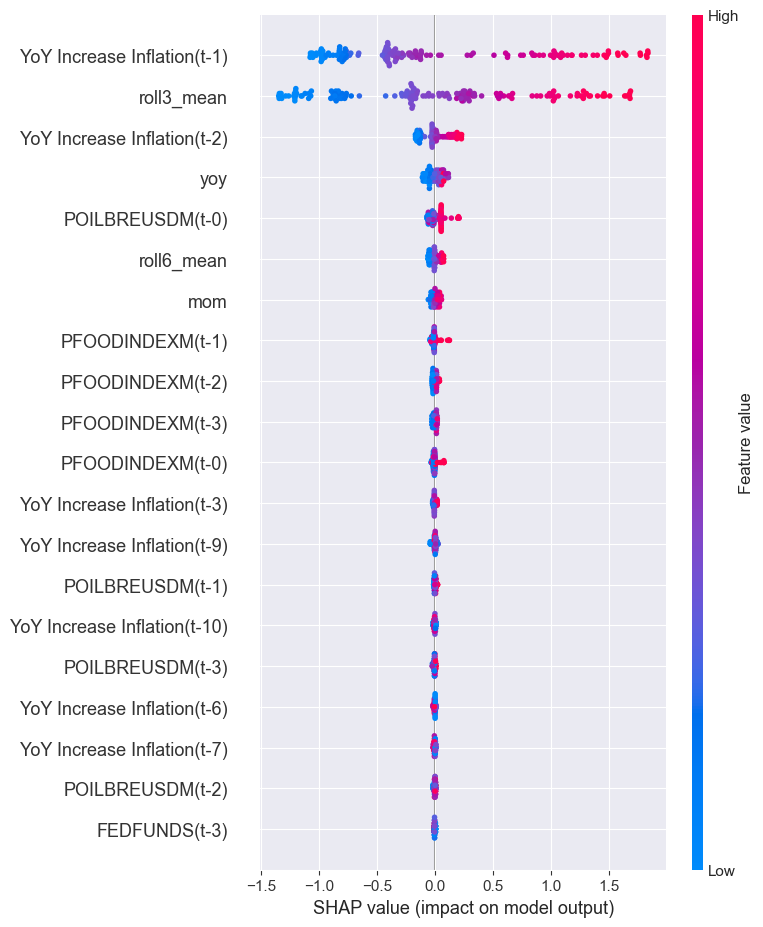

Training set bias (mean residual): 0.0016
Running recursive forecast with feature generation...
Forecast [4.05017492 4.11439849 4.45014824 4.45782764 4.33318238 4.42653835
 4.47262669 4.56065078 4.56257906 4.65068613 4.80369744 5.08929688]
Recursive forecast time: 0.13 seconds
rmse_ts: 0.13046193774980444
y hat ts: [[4.05017492]
 [4.11439849]
 [4.45014824]
 [4.45782764]
 [4.33318238]
 [4.42653835]
 [4.47262669]
 [4.56065078]
 [4.56257906]
 [4.65068613]
 [4.80369744]
 [5.08929688]]
Formatting results...
RMSE: 0.1305
MAPE: 2.43%
R²: 0.781, R²_bar: 0.781
fine after formatting results
exog_data shape (397, 12)
last index of exog_data 2025-04-01 00:00:00
LAST FULL_DATA INDEX 2025-04-01 00:00:00
future_start 2025-05-01 00:00:00
(154, 42) all _data, exogenous lagged data merged successfully.
full_data shape after feature engineering:  (154, 42)
future exog shape: (12, 12)
target Pickle object created
Pickle object created
forecast_month: 2025-05-01 00:00:00
future_exog index dtype: datetime64

Bootstrapping: 100%|██████████| 100/100 [02:07<00:00,  1.28s/it]


finished bootstrapping 
conf ints
lower_bounds: [4.24796638 4.21217019 4.19151714 3.92853021 3.64565675 3.4956726
 3.45079763 3.36033695 3.22918503 3.20407748 3.18751278 3.17883388]
upper_bounds: [5.62838119 5.70494251 5.82778086 5.90557971 6.04321041 6.24340949
 6.47408619 6.61437322 6.62959041 6.76328595 7.03335466 7.19224107]


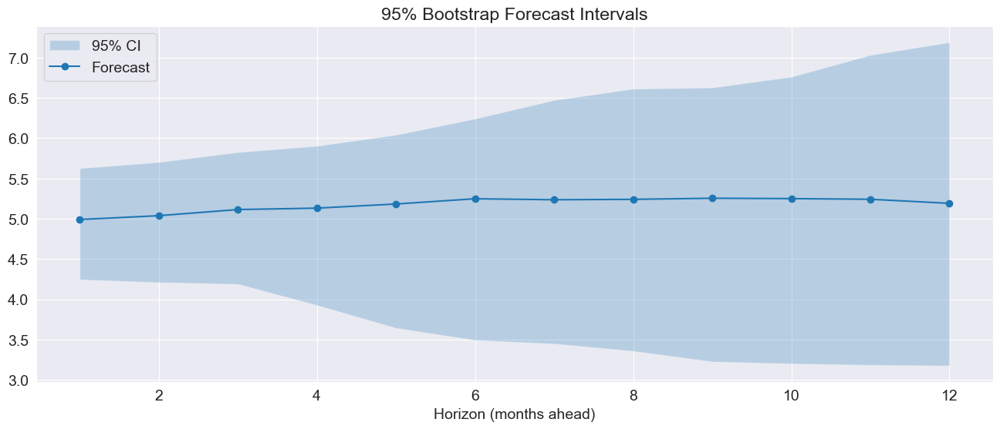

RMSE: 0.5671
MAPE: 10.58%
R²: -3.140, R²_bar: -0.100
all_Y: 2024-06-01    4.306715
2024-07-01    4.459012
2024-08-01    4.224229
2024-09-01    4.268600
2024-10-01    4.506714
2024-11-01    4.601015
2024-12-01    4.544254
2025-01-01    4.449295
2025-02-01    4.756221
2025-03-01    5.026616
2025-04-01    5.036721
2025-05-01    5.061159
2025-05-01    5.054364
2025-06-01    5.148379
2025-07-01    5.217114
2025-08-01    5.261309
2025-09-01    5.324748
2025-10-01    5.394853
2025-11-01    5.400885
2025-12-01    5.451889
2026-01-01    5.498058
2026-02-01    5.638746
2026-03-01    5.633815
2026-04-01    5.568434
dtype: float64
forecast: 2025-05-01    5.054364
2025-06-01    5.148379
2025-07-01    5.217114
2025-08-01    5.261309
2025-09-01    5.324748
2025-10-01    5.394853
2025-11-01    5.400885
2025-12-01    5.451889
2026-01-01    5.498058
2026-02-01    5.638746
2026-03-01    5.633815
2026-04-01    5.568434
Name: predicted_mean, dtype: float64


 57%|█████▋    | 4/7 [14:23<11:20, 226.90s/it]

Forecast object saved to  reports\\2025/June/2025-06-20/SUR10/Random Forest w/ Lags/SUR10 _Inflation_204125_forecast_object.json
Completed processing SUR10 with model random_forest_w_lags
Began processing country: CEN09
Processing CEN09 with model random_forest_w_lags
Training  random_forest_w_lags for  CEN09
✅ Overlap: 171 timestamps match
✅ Merge successful. Shape: (171, 24)
Training data after featuring engineering:  (171, 24)
X_shape: (159, 41) Y shape: (159, 1)
Training Random Forest model with RandomizedSearchCV...


Random search fits:   0%|          | 0/375 [00:00<?, ?it/s]

  0%|          | 0/375 [00:00<?, ?it/s]

Random Forest model training time: 19.09 seconds
Best parameters found: {'n_estimators': 75, 'min_samples_split': 2, 'min_samples_leaf': 1, 'max_features': 0.7, 'max_depth': 900, 'bootstrap': False}
Best score (RMSE): 0.8032559549088726
Training updated model with best parameters...for intermediate steps
Best Random Forest model training time: 1.06 seconds
Fold 1: train=36, test=36
Fold 2: train=72, test=36
Fold 3: train=108, test=36
Fold 4: train=144, test=3


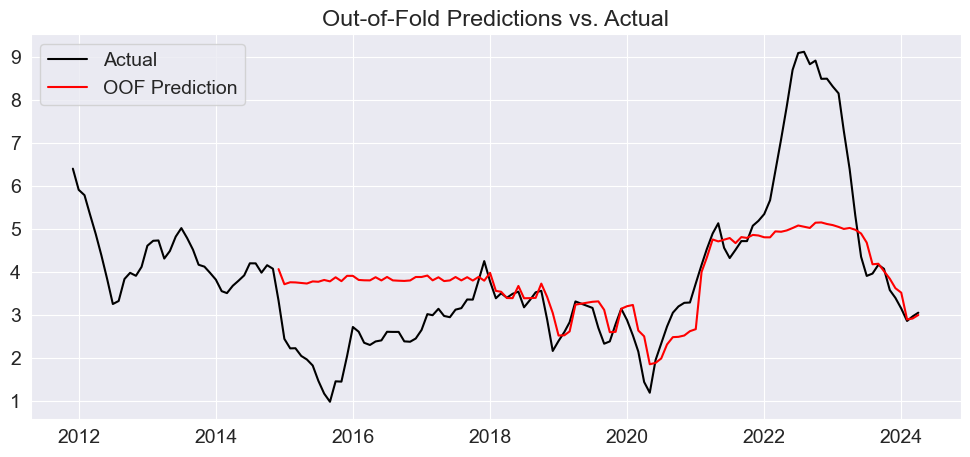

Out-of-fold RMSE: 1.4414


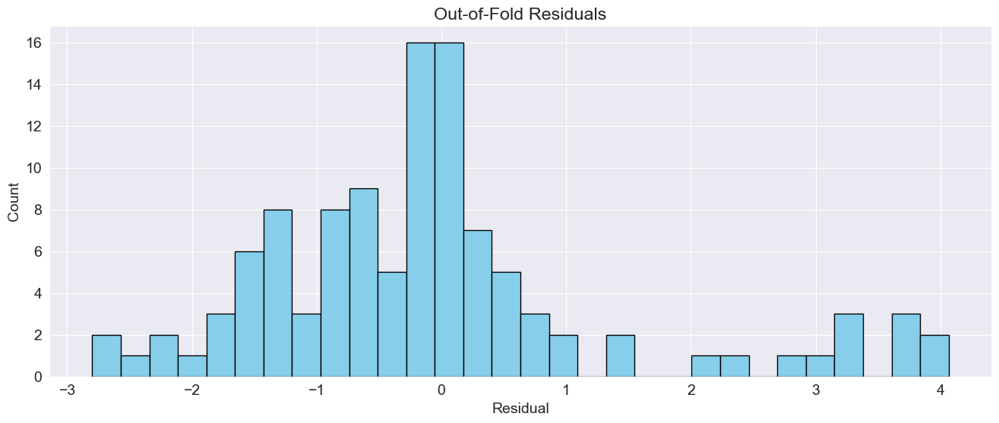

Testing different tree counts with tqdm progress bar...


Tree count sweep:   0%|          | 0/8 [00:00<?, ?it/s]

150 trees → avg CV RMSE = 1.014
300 trees → avg CV RMSE = 0.996
Δ RMSE from previous: 0.01844
500 trees → avg CV RMSE = 0.983
Δ RMSE from previous: 0.01256
800 trees → avg CV RMSE = 0.984
Δ RMSE from previous: 0.00076
No improvement count: 1
1000 trees → avg CV RMSE = 0.986
Δ RMSE from previous: 0.00131
1200 trees → avg CV RMSE = 0.984
Δ RMSE from previous: 0.00108
1400 trees → avg CV RMSE = 0.985
Δ RMSE from previous: 0.00093
No improvement count: 1
1500 trees → avg CV RMSE = 0.986
Δ RMSE from previous: 0.00032
No improvement count: 2
Early stopping triggered at 1500 trees.

✅ Best number of trees: 500 with avg CV RMSE = 0.983


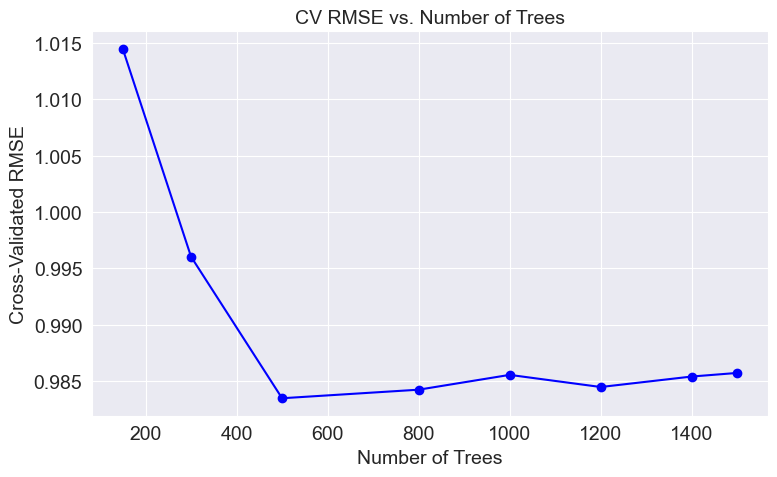

Training final Random Forest model with best parameters...
Final model training time: 0.86 seconds


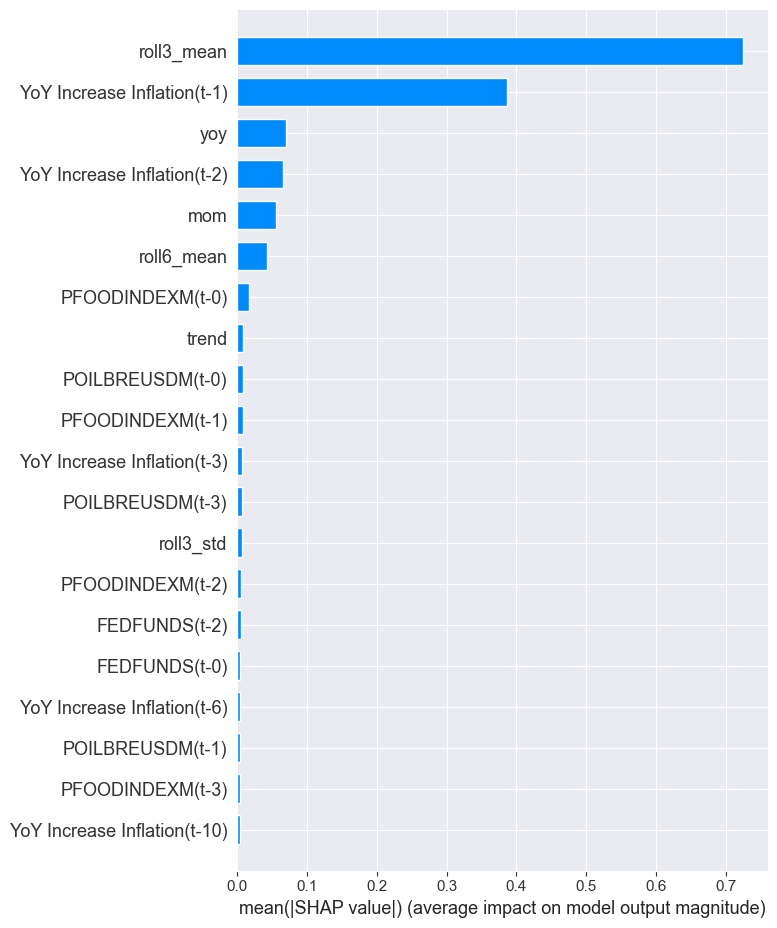

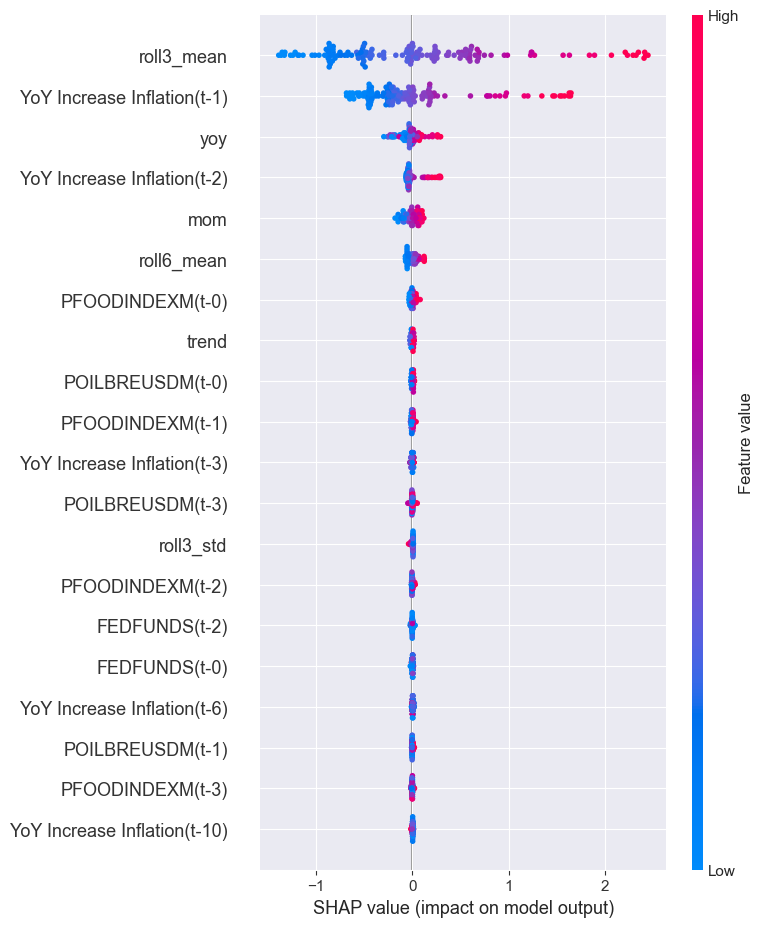

Training set bias (mean residual): -0.0022
Running recursive forecast with feature generation...
Forecast [3.08097442 3.1523901  3.22986881 3.00422093 2.75393595 2.25907763
 2.12412972 2.04706593 2.37345491 2.55818639 2.50578713 2.21428734]
Recursive forecast time: 0.06 seconds
rmse_ts: 0.2253683063975864
y hat ts: [[3.08097442]
 [3.1523901 ]
 [3.22986881]
 [3.00422093]
 [2.75393595]
 [2.25907763]
 [2.12412972]
 [2.04706593]
 [2.37345491]
 [2.55818639]
 [2.50578713]
 [2.21428734]]
Formatting results...
RMSE: 0.2254
MAPE: 8.07%
R²: 0.818, R²_bar: 0.818
fine after formatting results
exog_data shape (397, 12)
last index of exog_data 2025-04-01 00:00:00
LAST FULL_DATA INDEX 2025-04-01 00:00:00
future_start 2025-05-01 00:00:00
(154, 42) all _data, exogenous lagged data merged successfully.
full_data shape after feature engineering:  (154, 42)
future exog shape: (12, 12)
target Pickle object created
Pickle object created
forecast_month: 2025-05-01 00:00:00
future_exog index dtype: datetime64

Bootstrapping: 100%|██████████| 100/100 [01:12<00:00,  1.37it/s]


finished bootstrapping 
conf ints
lower_bounds: [2.15350512 2.18319927 2.18838748 2.19025171 2.28689959 2.36199253
 2.38746095 2.44162578 2.49230895 2.52413248 2.51768195 2.51798753]
upper_bounds: [3.98713285 4.01799786 4.58498751 5.42493651 5.61780387 5.87643393
 6.04971225 6.85967245 7.07888699 7.28116579 7.4077732  7.55621547]


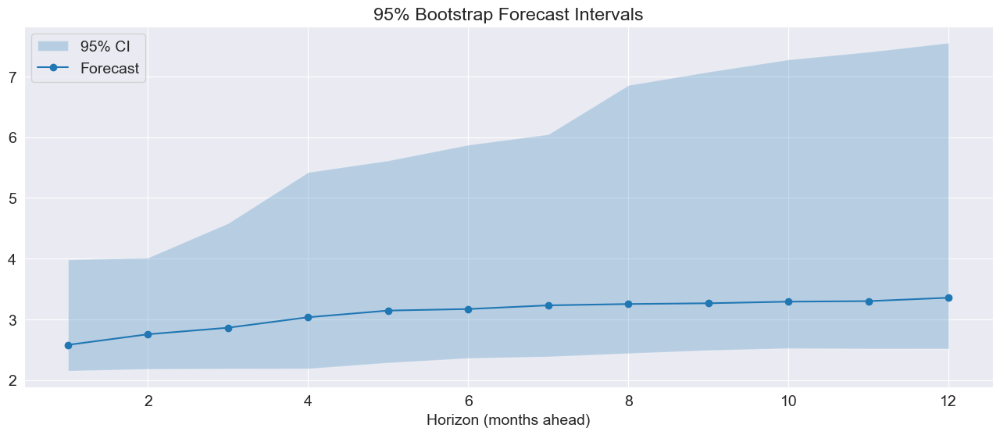

RMSE: 0.7681
MAPE: 30.88%
R²: -1.116, R²_bar: -0.100
all_Y: 2024-06-01    3.192680
2024-07-01    3.377360
2024-08-01    2.989147
2024-09-01    2.383965
2024-10-01    1.865021
2024-11-01    2.031399
2024-12-01    2.102893
2025-01-01    2.315887
2025-02-01    2.401485
2025-03-01    2.122668
2025-04-01    1.929695
2025-05-01    1.197920
2025-05-01    2.214563
2025-06-01    2.308371
2025-07-01    2.362748
2025-08-01    2.530106
2025-09-01    2.674671
2025-10-01    2.633680
2025-11-01    2.666412
2025-12-01    2.666833
2026-01-01    2.634881
2026-02-01    2.616961
2026-03-01    2.619707
2026-04-01    2.603553
dtype: float64
forecast: 2025-05-01    2.214563
2025-06-01    2.308371
2025-07-01    2.362748
2025-08-01    2.530106
2025-09-01    2.674671
2025-10-01    2.633680
2025-11-01    2.666412
2025-12-01    2.666833
2026-01-01    2.634881
2026-02-01    2.616961
2026-03-01    2.619707
2026-04-01    2.603553
Name: predicted_mean, dtype: float64


 71%|███████▏  | 5/7 [17:19<06:57, 208.56s/it]

Forecast object saved to  reports\\2025/June/2025-06-20/CEN09/Random Forest w/ Lags/CEN09 _Inflation_204421_forecast_object.json
Completed processing CEN09 with model random_forest_w_lags
Began processing country: CEN10
Processing CEN10 with model random_forest_w_lags
Training  random_forest_w_lags for  CEN10
✅ Overlap: 171 timestamps match
✅ Merge successful. Shape: (171, 24)
Training data after featuring engineering:  (171, 24)
X_shape: (159, 41) Y shape: (159, 1)
Training Random Forest model with RandomizedSearchCV...


Random search fits:   0%|          | 0/375 [00:00<?, ?it/s]

  0%|          | 0/375 [00:00<?, ?it/s]

Random Forest model training time: 23.02 seconds
Best parameters found: {'n_estimators': 75, 'min_samples_split': 2, 'min_samples_leaf': 1, 'max_features': 0.7, 'max_depth': 900, 'bootstrap': False}
Best score (RMSE): 0.7031962367767483
Training updated model with best parameters...for intermediate steps
Best Random Forest model training time: 1.35 seconds
Fold 1: train=36, test=36
Fold 2: train=72, test=36
Fold 3: train=108, test=36
Fold 4: train=144, test=3


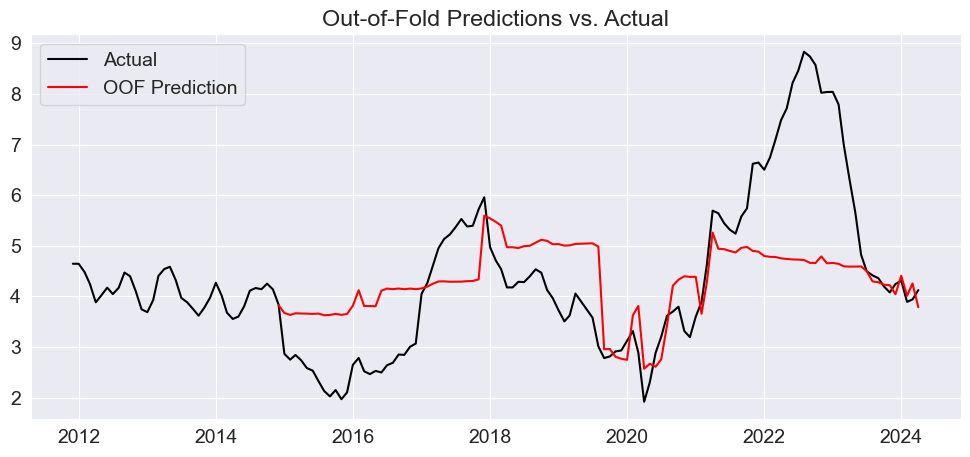

Out-of-fold RMSE: 1.4731


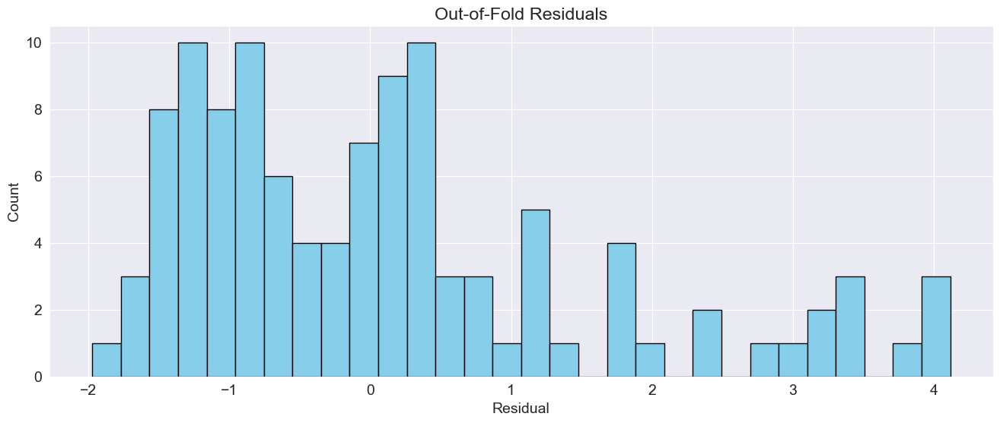

Testing different tree counts with tqdm progress bar...


Tree count sweep:   0%|          | 0/8 [00:00<?, ?it/s]

150 trees → avg CV RMSE = 1.092
300 trees → avg CV RMSE = 1.084
Δ RMSE from previous: 0.00804
500 trees → avg CV RMSE = 1.078
Δ RMSE from previous: 0.00668
800 trees → avg CV RMSE = 1.071
Δ RMSE from previous: 0.00605
1000 trees → avg CV RMSE = 1.071
Δ RMSE from previous: 0.00082
No improvement count: 1
1200 trees → avg CV RMSE = 1.073
Δ RMSE from previous: 0.00191
1400 trees → avg CV RMSE = 1.076
Δ RMSE from previous: 0.00308
1500 trees → avg CV RMSE = 1.076
Δ RMSE from previous: 0.00028
No improvement count: 1

✅ Best number of trees: 1000 with avg CV RMSE = 1.071


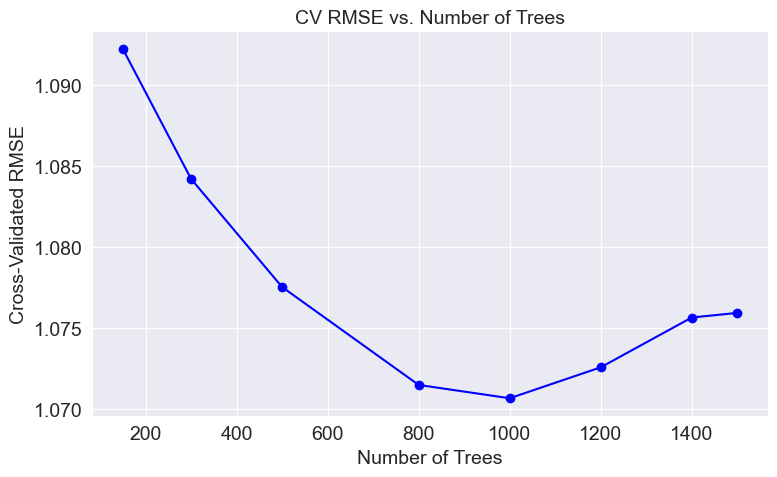

Training final Random Forest model with best parameters...
Final model training time: 1.84 seconds


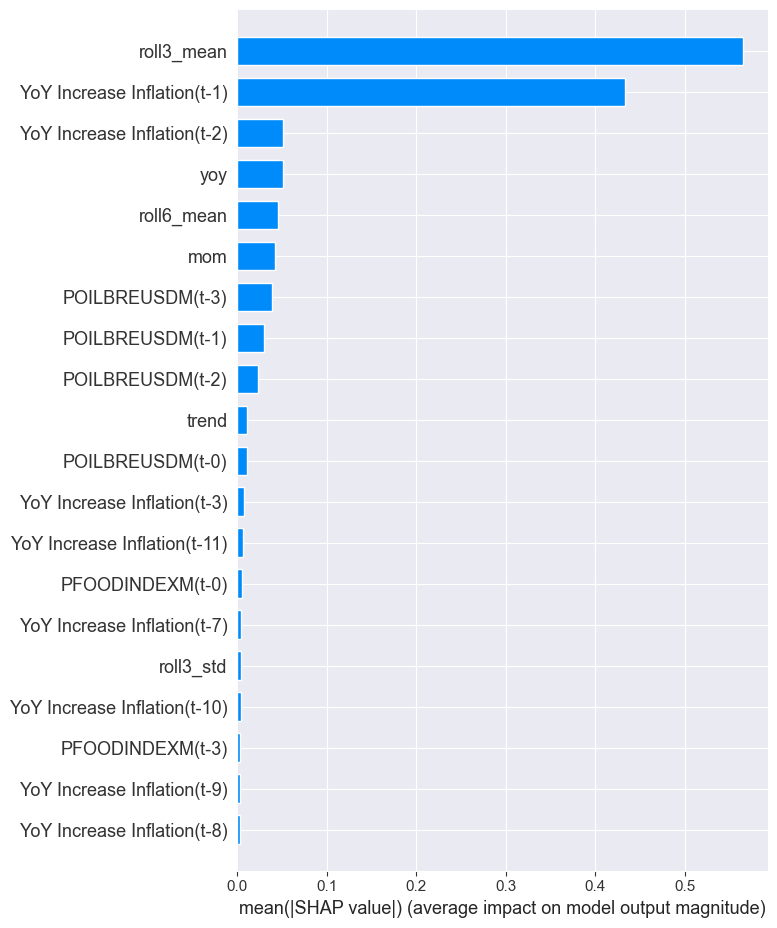

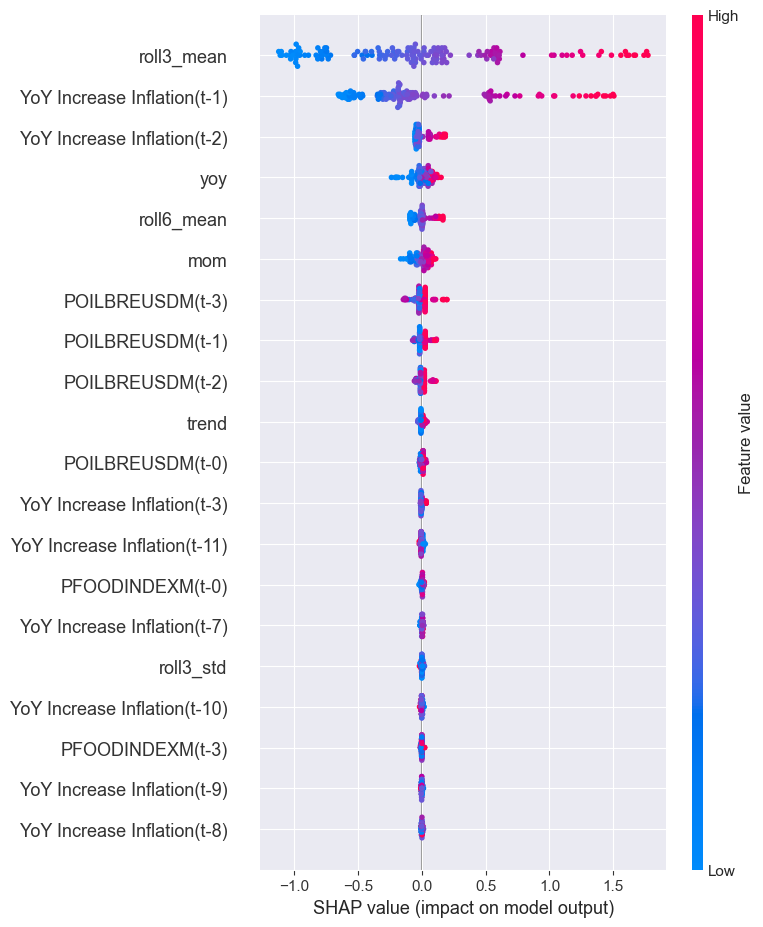

Training set bias (mean residual): -0.0009
Running recursive forecast with feature generation...
Forecast [4.12640783 4.27546579 4.43979855 4.41996295 4.10509018 3.87594589
 3.83412898 3.6314829  3.43745725 3.60880379 3.4185722  3.51656712]
Recursive forecast time: 0.09 seconds
rmse_ts: 0.21115693790635023
y hat ts: [[4.12640783]
 [4.27546579]
 [4.43979855]
 [4.41996295]
 [4.10509018]
 [3.87594589]
 [3.83412898]
 [3.6314829 ]
 [3.43745725]
 [3.60880379]
 [3.4185722 ]
 [3.51656712]]
Formatting results...
RMSE: 0.2112
MAPE: 5.00%
R²: 0.833, R²_bar: 0.833
fine after formatting results
exog_data shape (397, 12)
last index of exog_data 2025-04-01 00:00:00
LAST FULL_DATA INDEX 2025-04-01 00:00:00
future_start 2025-05-01 00:00:00
(154, 42) all _data, exogenous lagged data merged successfully.
full_data shape after feature engineering:  (154, 42)
future exog shape: (12, 12)
target Pickle object created
Pickle object created
forecast_month: 2025-05-01 00:00:00
future_exog index dtype: datetime6

Bootstrapping: 100%|██████████| 100/100 [02:00<00:00,  1.21s/it]


finished bootstrapping 
conf ints
lower_bounds: [3.21326488 3.18960738 3.16006957 3.12635512 3.12328036 3.18133765
 3.24336261 3.24283455 3.24155176 3.1917155  3.14749341 3.11864736]
upper_bounds: [4.56969512 4.74157818 5.20644931 5.58142131 5.74749512 5.91300352
 6.16294899 6.32032014 6.36349028 6.4716591  6.56398765 6.71750801]


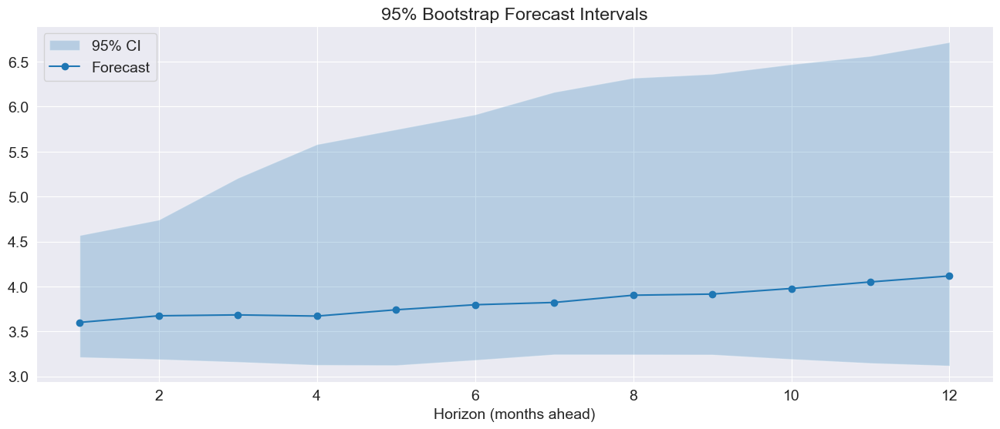

RMSE: 0.6073
MAPE: 14.94%
R²: -0.384, R²_bar: -0.100
all_Y: 2024-06-01    4.386696
2024-07-01    4.842821
2024-08-01    4.330685
2024-09-01    3.854527
2024-10-01    3.804316
2024-11-01    3.716778
2024-12-01    3.515222
2025-01-01    3.164279
2025-02-01    3.318911
2025-03-01    3.244679
2025-04-01    3.269128
2025-05-01    3.351787
2025-05-01    3.494923
2025-06-01    3.570902
2025-07-01    3.552866
2025-08-01    3.527661
2025-09-01    3.545593
2025-10-01    3.580032
2025-11-01    3.597429
2025-12-01    3.626068
2026-01-01    3.657913
2026-02-01    3.733207
2026-03-01    3.799550
2026-04-01    3.813980
dtype: float64
forecast: 2025-05-01    3.494923
2025-06-01    3.570902
2025-07-01    3.552866
2025-08-01    3.527661
2025-09-01    3.545593
2025-10-01    3.580032
2025-11-01    3.597429
2025-12-01    3.626068
2026-01-01    3.657913
2026-02-01    3.733207
2026-03-01    3.799550
2026-04-01    3.813980
Name: predicted_mean, dtype: float64


 86%|████████▌ | 6/7 [21:28<03:42, 222.17s/it]

Forecast object saved to  reports\\2025/June/2025-06-20/CEN10/Random Forest w/ Lags/CEN10 _Inflation_204830_forecast_object.json
Completed processing CEN10 with model random_forest_w_lags
Began processing country: CAR13
Processing CAR13 with model random_forest_w_lags
Training  random_forest_w_lags for  CAR13
✅ Overlap: 171 timestamps match
✅ Merge successful. Shape: (171, 24)
Training data after featuring engineering:  (171, 24)
X_shape: (159, 41) Y shape: (159, 1)
Training Random Forest model with RandomizedSearchCV...


Random search fits:   0%|          | 0/375 [00:00<?, ?it/s]

  0%|          | 0/375 [00:00<?, ?it/s]

Random Forest model training time: 18.94 seconds
Best parameters found: {'n_estimators': 100, 'min_samples_split': 5, 'min_samples_leaf': 2, 'max_features': 0.5, 'max_depth': 600, 'bootstrap': False}
Best score (RMSE): 0.7714293587167006
Training updated model with best parameters...for intermediate steps
Best Random Forest model training time: 0.91 seconds
Fold 1: train=36, test=36
Fold 2: train=72, test=36
Fold 3: train=108, test=36
Fold 4: train=144, test=3


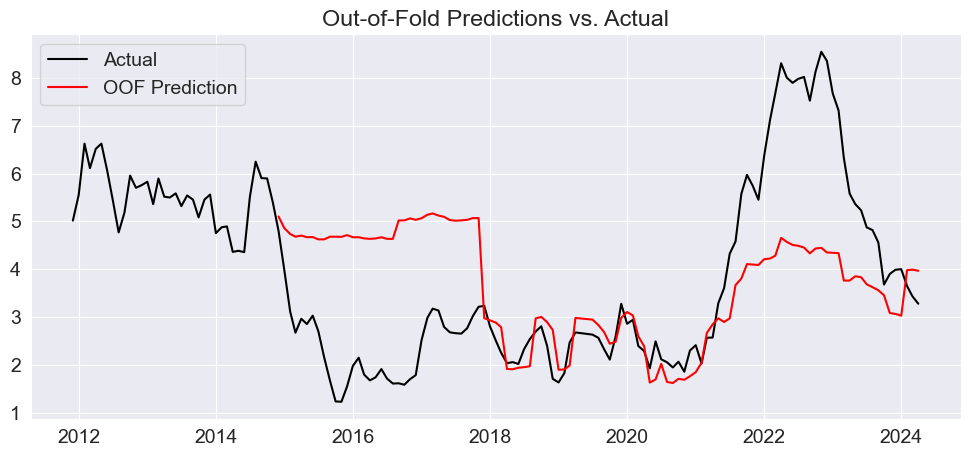

Out-of-fold RMSE: 1.9836


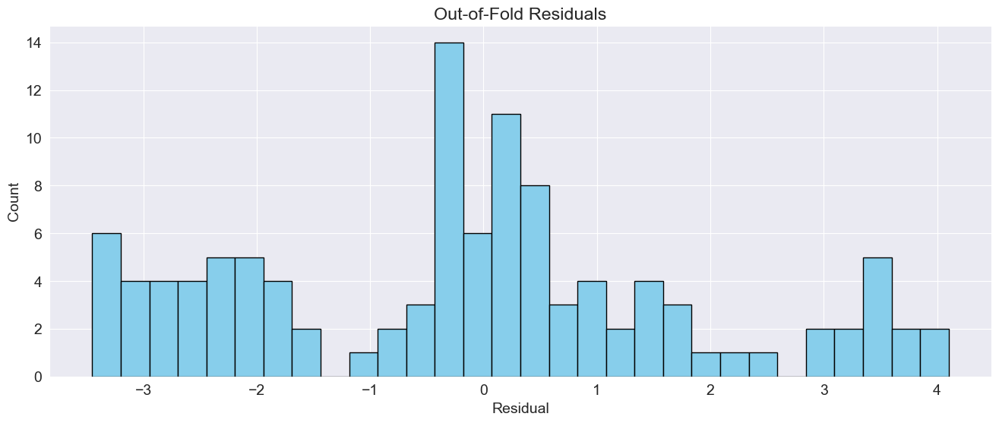

Testing different tree counts with tqdm progress bar...


Tree count sweep:   0%|          | 0/8 [00:00<?, ?it/s]

150 trees → avg CV RMSE = 1.058
300 trees → avg CV RMSE = 1.048
Δ RMSE from previous: 0.00996
500 trees → avg CV RMSE = 1.047
Δ RMSE from previous: 0.00119
800 trees → avg CV RMSE = 1.049
Δ RMSE from previous: 0.00184
1000 trees → avg CV RMSE = 1.044
Δ RMSE from previous: 0.00484
1200 trees → avg CV RMSE = 1.043
Δ RMSE from previous: 0.00095
No improvement count: 1
1400 trees → avg CV RMSE = 1.044
Δ RMSE from previous: 0.00140
1500 trees → avg CV RMSE = 1.043
Δ RMSE from previous: 0.00105

✅ Best number of trees: 1200 with avg CV RMSE = 1.043


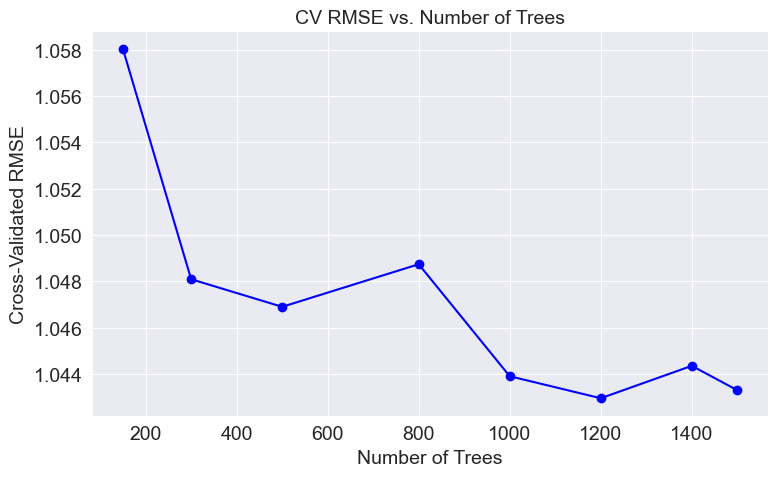

Training final Random Forest model with best parameters...
Final model training time: 2.03 seconds


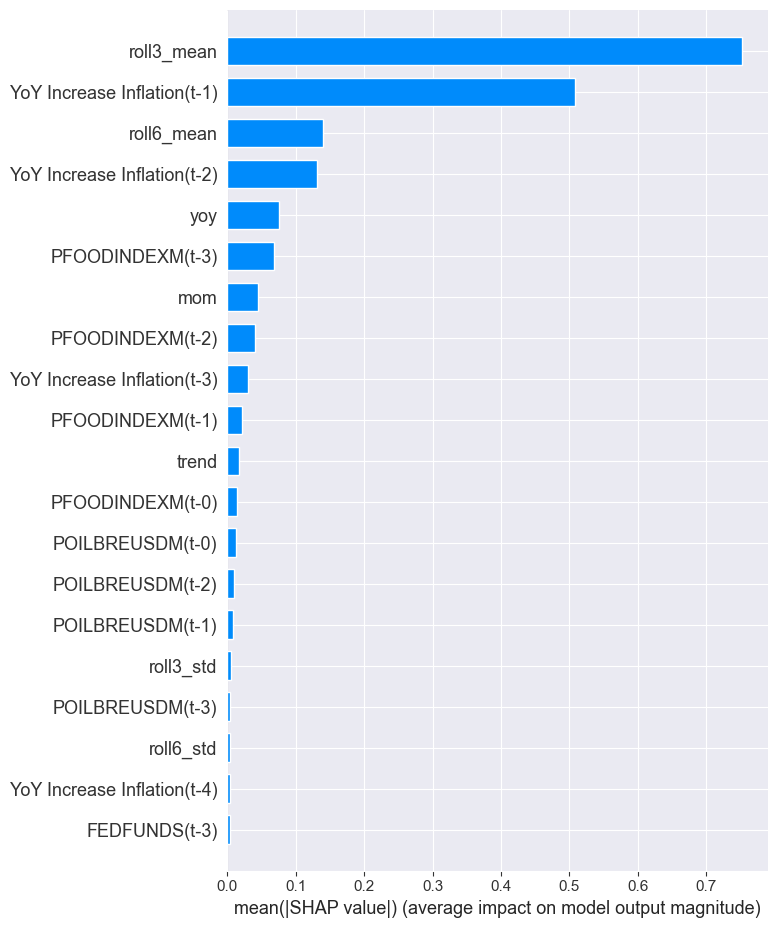

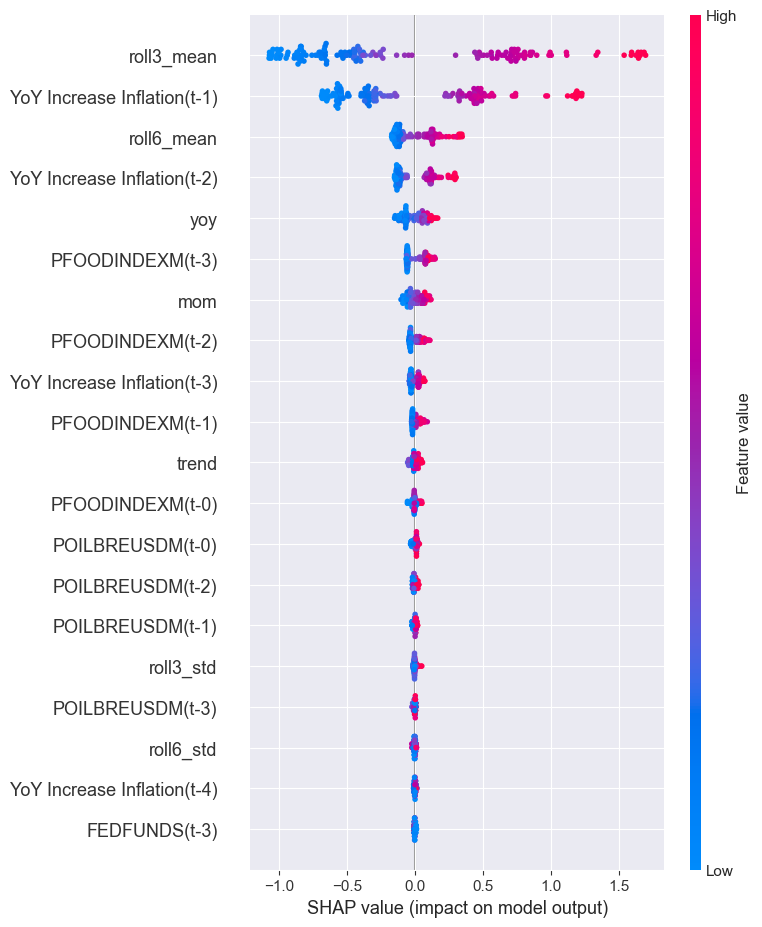

Training set bias (mean residual): 0.0004
Running recursive forecast with feature generation...
Forecast [3.49055201 3.56295891 3.56163414 3.54453894 3.57478067 3.47213107
 3.34889745 3.28364551 3.29473103 3.26209377 3.06631319 3.02983203]
Recursive forecast time: 0.11 seconds
rmse_ts: 0.5174166071351932
y hat ts: [[3.49055201]
 [3.56295891]
 [3.56163414]
 [3.54453894]
 [3.57478067]
 [3.47213107]
 [3.34889745]
 [3.28364551]
 [3.29473103]
 [3.26209377]
 [3.06631319]
 [3.02983203]]
Formatting results...
RMSE: 0.5174
MAPE: 16.78%
R²: -1.523, R²_bar: -0.100
fine after formatting results
exog_data shape (397, 12)
last index of exog_data 2025-04-01 00:00:00
LAST FULL_DATA INDEX 2025-04-01 00:00:00
future_start 2025-05-01 00:00:00
(154, 42) all _data, exogenous lagged data merged successfully.
full_data shape after feature engineering:  (154, 42)
future exog shape: (12, 12)
target Pickle object created
Pickle object created
forecast_month: 2025-05-01 00:00:00
future_exog index dtype: datetime

Bootstrapping: 100%|██████████| 100/100 [02:14<00:00,  1.34s/it]


finished bootstrapping 
conf ints
lower_bounds: [2.53752312 2.49270257 2.55968502 2.55794792 2.5393654  2.54195394
 2.63721153 2.66377183 2.67981945 2.69288501 2.7231549  2.71508673]
upper_bounds: [3.77926666 4.17679776 4.8235052  5.006063   5.14668895 5.44357048
 5.6279094  5.70111651 5.71883966 5.77592624 5.83930621 5.86733744]


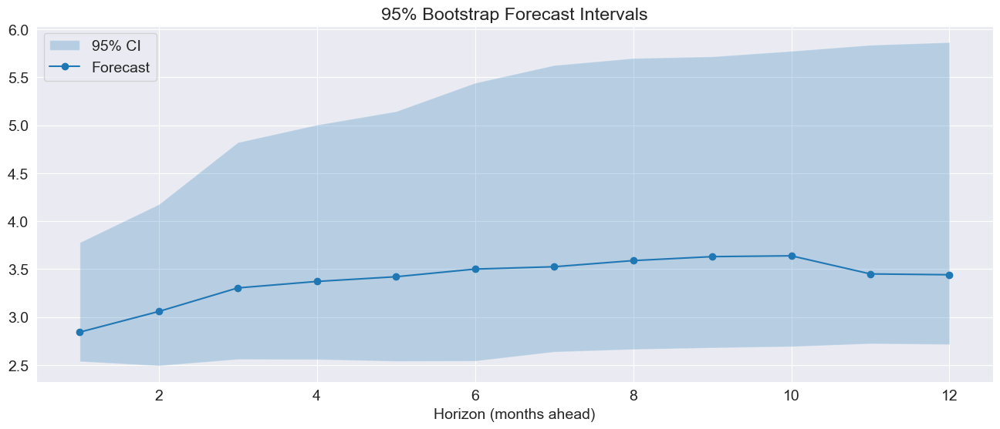

RMSE: 0.4887
MAPE: 15.45%
R²: -1.251, R²_bar: -0.100
all_Y: 2024-05-01    3.350762
2024-06-01    3.307937
2024-07-01    3.010200
2024-08-01    3.493969
2024-09-01    3.098681
2024-10-01    2.707670
2024-11-01    2.533116
2024-12-01    2.851681
2025-01-01    2.840311
2025-02-01    2.484910
2025-03-01    2.706914
2025-04-01    2.562305
2025-05-01    2.882713
2025-06-01    3.132048
2025-07-01    3.423212
2025-08-01    3.492851
2025-09-01    3.557149
2025-10-01    3.601410
2025-11-01    3.641977
2025-12-01    3.672956
2026-01-01    3.671808
2026-02-01    3.677608
2026-03-01    3.660058
2026-04-01    3.647655
dtype: float64
forecast: 2025-05-01    2.882713
2025-06-01    3.132048
2025-07-01    3.423212
2025-08-01    3.492851
2025-09-01    3.557149
2025-10-01    3.601410
2025-11-01    3.641977
2025-12-01    3.672956
2026-01-01    3.671808
2026-02-01    3.677608
2026-03-01    3.660058
2026-04-01    3.647655
Name: predicted_mean, dtype: float64


100%|██████████| 7/7 [25:36<00:00, 219.57s/it]

Forecast object saved to  reports\\2025/June/2025-06-20/CAR13/Random Forest w/ Lags/CAR13 _Inflation_205238_forecast_object.json
Completed processing CAR13 with model random_forest_w_lags


In [15]:
create_forecast_report(REG_data, [], random_forest_w_lags, walkforward=False, log_transform=False)


In [16]:
#set pickle obj to forecast_input 
# with open('future_exog_step_0.pkl', 'wb') as f:
#     pickle.dump(future_exog, f) 

#see contents of pkl object
with open('future_exog_step_0.pkl', 'rb') as f:
    future_exog = pickle.load(f)

with open('series.pkl', 'rb') as f:
    series = pickle.load(f)

    forecast_month = series.index[-1] + pd.DateOffset(months=1)

print(forecast_month)

2026-04-01 00:00:00


In [17]:
if forecast_month in future_exog.index:
    exog_row = future_exog.loc[[forecast_month]]  # keep it as a row
    print(f"✅ Found exog data for {forecast_month}.")
else:
    print(f"⚠️ No exog data found for {forecast_month}. Filling with NaN.")


✅ Found exog data for 2026-04-01 00:00:00.


In [18]:
series.index
#overlap between future_exog and series index    
overlap = future_exog.index.intersection(series.index)
if overlap.empty:
    print("⚠️ No overlap found between future_exog and series index.")
if not overlap.empty:
    print(f"✅ Overlap found for {overlap[0]}: {future_exog.loc[overlap[0]]}")

✅ Overlap found for 2025-05-01 00:00:00: FEDFUNDS(t-1)         4.100000
FEDFUNDS(t-2)         0.791547
FEDFUNDS(t-3)         4.100000
FEDFUNDS(t-0)         4.100000
POILBREUSDM(t-1)     67.670000
POILBREUSDM(t-2)      0.353619
POILBREUSDM(t-3)     67.670000
POILBREUSDM(t-0)     67.670000
PFOODINDEXM(t-1)    128.329000
PFOODINDEXM(t-2)      1.380978
PFOODINDEXM(t-3)    128.329000
PFOODINDEXM(t-0)    128.329000
Name: 2025-05-01 00:00:00, dtype: float64


In [19]:
forecast_month = series.index[-1] + pd.DateOffset(months=1)
future_exog.index.to_period('M').to_timestamp()

forecast_month



Timestamp('2026-04-01 00:00:00')

In [20]:
import pandasdmx


with open(r"C:\Users\tfarotimi\Downloads\WEOAPR2025-SDMXData\WEOAPR2025\xmlfile_APR2025.xml", "rb") as f:
    message = pandasdmx.parse(f)

# Inspect available data
print(message.data)

AttributeError: module 'pandasdmx' has no attribute 'parse'

In [ ]:
#stop further execution 
System.exit(0)

NameError: name 'System' is not defined

In [ ]:
# for group in all_data.keys():
#         print(f"Running model search for {group}")
#         run_models(all_data[group])

In [ ]:
all_data['SUR_data']['BOL'].tail()

,YoY Increase Inflation
Period,
2024-12-01,9.973851
2025-01-01,12.034367
2025-02-01,13.223088
2025-03-01,14.633914
2025-04-01,15.005067


In [ ]:
all_data.keys()

dict_keys(['SUR_data', 'CEN_data', 'CAR_data', 'REG_data'])

In [ ]:
# GLOBAL_EXOG_DATA_FILE = r"C:\Users\tfarotimi\Documents\CEPAL\Inflation Forecasting\dat\2023\October\Energy and Food Index_20232011.xlsx"



# for region in all_data:
#     create_forecast_report(all_data[region], [], random_forest_w_lags, walkforward=False, log_transform=False)

# # REG_data = all_data['REG_data']
create_forecast_report(REG_data, ['md_R01'], random_forest_w_lags, walkforward=False, log_transform=False)

  0%|          | 0/7 [00:00<?, ?it/s]

Training  random_forest_w_lags for  md_R01


Random search fits:   0%|          | 0/375 [00:00<?, ?it/s]

  0%|          | 0/375 [00:00<?, ?it/s]

150 trees → avg OOB RMSE = 0.978
300 trees → avg OOB RMSE = 0.949
500 trees → avg OOB RMSE = 0.955
800 trees → avg OOB RMSE = 0.948
1000 trees → avg OOB RMSE = 0.958
1200 trees → avg OOB RMSE = 0.949


  0%|          | 0/7 [02:06<?, ?it/s]


KeyboardInterrupt: 

In [ ]:
#stop further execution
raise SystemExit("Stopping further execution after creating forecast report for REG_data.")

SystemExit: Stopping further execution after creating forecast report for REG_data.

In [ ]:
# create_forecast_report(all_data[3], ['R01'], random_forest_w_lags, log_transform=False, walkforward=False)

In [ ]:
for i, region in enumerate(all_data):
    print (i, region.keys())

0 dict_keys(['ARG', 'BOL', 'BRA', 'CHL', 'COL', 'ECU', 'PRY', 'PER', 'URY', 'VEN'])
1 dict_keys(['MEX', 'CRI', 'CUB', 'DOM', 'SLV', 'GTM', 'HTI', 'HND', 'NIC', 'PAN'])
2 dict_keys(['ATG', 'BHS', 'BRB', 'BLZ', 'DMA', 'GRD', 'GUY', 'JAM', 'KNA', 'VCT', 'LCA', 'SUR', 'TTO'])
3 dict_keys(['md_R01', 'md_R02', 'md_R07', 'md_SUR10', 'md_CEN09', 'md_CEN10', 'md_CAR13'])


In [ ]:
for i, region in enumerate(all_data):
    print(f"Region {i+1}: {region}")
    create_forecast_report(region,[], random_forest_w_lags, log_transform = False, walkforward = False)    

Region 1: SUR_data


AttributeError: 'str' object has no attribute 'keys'

In [ ]:
raise SystemExit("Execution stopped. Please check the code and try again.")

SystemExit: Execution stopped. Please check the code and try again.

In [ ]:
#stop executing 
# create_aggregate_report(all_data, random_forest_w_lags, log_transform=False, walkforward=False)


In [ ]:
# Store processed data in a dictionary with keys like 'ARG_data', 'BOL_data', etc.
# SUR_data = all_data[0]


In [ ]:
# chl_rf = run_monthly_forecast(random_forest_w_lags, SUR_data,['CHL'], log_transform=False, walkforward=False)

# #SAVE TO FILE 
# with open('chl_rf.pkl', 'wb') as f:
#     pickle.dump(chl_rf, f)

# # Load the saved data
# with open('chl_rf.pkl', 'rb') as f:
#     chl_rf = pickle.load(f)

In [ ]:
# #store chl_rf[0] for later use 
# chl_rf_data = chl_rf[0]
# chl_rf_data['model']
# chl_rf_data['model'] = 'Random Forest with Lags'
# # Save the modified data back to the file
# with open('chl_rf.pkl', 'wb') as f:
#     pickle.dump(chl_rf, f)


# #load the saved data
# with open('chl_rf.pkl', 'rb') as f:
#     chl_rf = pickle.load(f)


In [ ]:

# chl_rf[0]['model'] = 'Random Forest'

In [ ]:
create_forecast_report(SUR_data, ['CHL'], random_forest_w_lags, log_transform=False, walkforward=False)

  0%|          | 0/10 [00:00<?, ?it/s]

Training  random_forest_w_lags for  CHL


100%|██████████| 10/10 [02:20<00:00, 14.03s/it]


In [ ]:
# from models import random_forest_w_lags


# create_forecast_report(SUR_data, ['CHL'], random_forest_w_lags, log_transform = False, walkforward = True)
# # create_forecast_report(CEN_data, [], arima, log_transform = False, walkforward = True)
# # create_forecast_report(CAR_data, [], arima, log_transform = False, walkforward = True)
# # create_forecast_report(REG_data, [], arima, log_transform = False, walkforward = True)


In [ ]:
# create_forecast_report(SUR_data, [], cnn_model, log_transform = False, walkforward = False)
# create_forecast_report(CEN_data, [], cnn_model, log_transform = False, walkforward = False)
# create_forecast_report(CAR_data, [], cnn_model, log_transform = False, walkforward = False)
# create_forecast_report(REG_data, [], cnn_model, log_transform = False, walkforward = False)

In [ ]:
# create_forecast_report(SUR_data, sarimax,[], log_transform = False, walkforward = False)
# create_forecast_report(CEN_data, sarimax,[], log_transform = False, walkforward = False)
# create_forecast_report(CAR_data, sarimax,[], log_transform = False, walkforward = False)
# create_forecast_report(REG_data, sarimax,[], log_transform = False, walkforward = False)

In [ ]:
# #stop further execution 
# raise SystemExit("Execution stopped. Please check the code and try again.")

In [ ]:
all_data

[{'ARG':             YoY Increase Inflation
  Period                            
  2005-01-01                7.222511
  2005-02-01                8.128004
  2005-03-01                9.151802
  2005-04-01                8.753909
  2005-05-01                8.613664
  ...                            ...
  2024-12-01              117.763627
  2025-01-01               84.537508
  2025-02-01               66.874146
  2025-03-01               55.930016
  2025-04-01               47.260264
  
  [244 rows x 1 columns],
  'BOL':             YoY Increase Inflation
  Period                            
  2019-01-01                1.427647
  2019-02-01                0.950864
  2019-03-01                1.062694
  2019-04-01                1.348656
  2019-05-01                1.691135
  ...                            ...
  2024-12-01                9.973851
  2025-01-01               12.034367
  2025-02-01               13.223088
  2025-03-01               14.633914
  2025-04-01               15.00

In [ ]:
REG_data

NameError: name 'REG_data' is not defined

In [ ]:
region['CAR13']

,YoY Increase Inflation,YoY Increase Crude oil WTI,YoY Increase Index Energy,YoY Increase Index Food
Period,,,,
1991-01-01,0.000000,9.050773,8.264631,-4.583703
1991-02-01,0.000000,-7.013575,-2.920760,-2.060931
1991-03-01,0.000000,-2.450980,4.556641,-0.070551
1991-04-01,0.000000,11.827957,12.371952,-3.555511
1991-05-01,0.000000,15.176152,12.082295,-5.277098
...,...,...,...,...
2024-12-01,2.617300,NaN,NaN,NaN
2025-01-01,2.613791,NaN,NaN,NaN
2025-02-01,2.289534,NaN,NaN,NaN


  0%|          | 0/1 [00:00<?, ?it/s]

Training  arima for  CAR13_raw
Fitting ARIMA model for:  CAR13_raw


100%|██████████| 1/1 [00:00<00:00, 206.72it/s]


Training  sarimax for  CAR13_raw
An error occurred while training the model sarimax for:  CAR13_raw <class 'ValueError'>


100%|██████████| 1/1 [00:00<00:00,  9.97it/s]

Training  varmax for  CAR13_raw
An error occurred while training the model varmax for:  CAR13_raw <class 'ValueError'>


  0%|          | 0/1 [00:00<?, ?it/s]

Training  arima for  CAR13_lt
Fitting ARIMA model for:  CAR13_lt


100%|██████████| 1/1 [00:00<00:00, 49.74it/s]


Training  sarimax for  CAR13_lt
An error occurred while training the model sarimax for:  CAR13_lt <class 'ValueError'>


  0%|          | 0/1 [00:00<?, ?it/s]

Training  varmax for  CAR13_lt


100%|██████████| 1/1 [00:00<00:00,  7.62it/s]


An error occurred while training the model varmax for:  CAR13_lt <class 'ValueError'>
Best Model for  CAR13  is  CAR13lt_arima_results
  Country  Model                      Params Log Transform  RMSE Naive RMSE  \
0   CAR13  ARIMA  [(3, 2, 0), (3, 0, 1, 12)]          True  1.05       0.82   
1   CAR13  ARIMA  [(2, 1, 0), (0, 0, 1, 12)]         False  1.30       0.63   

    MAPE Naive MAPE            Results Set  
0  44.07      27.39  CAR13lt_arima_results  
1  52.87      15.25     CAR13arima_results  


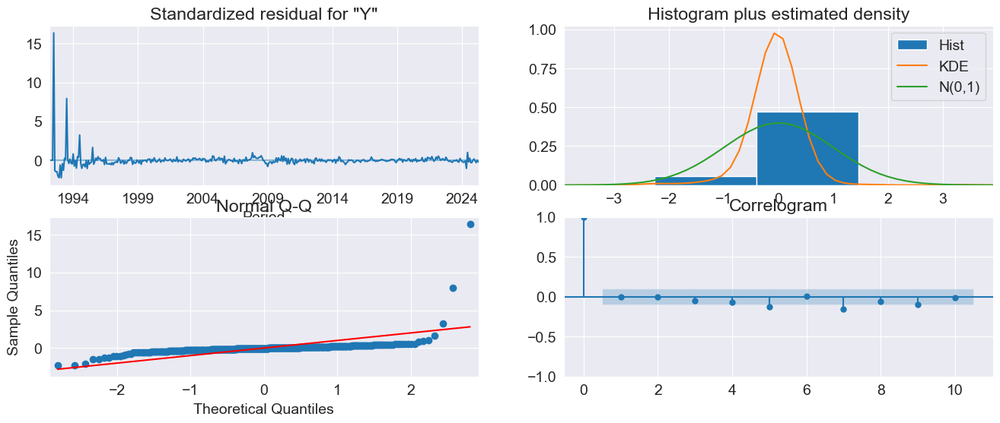

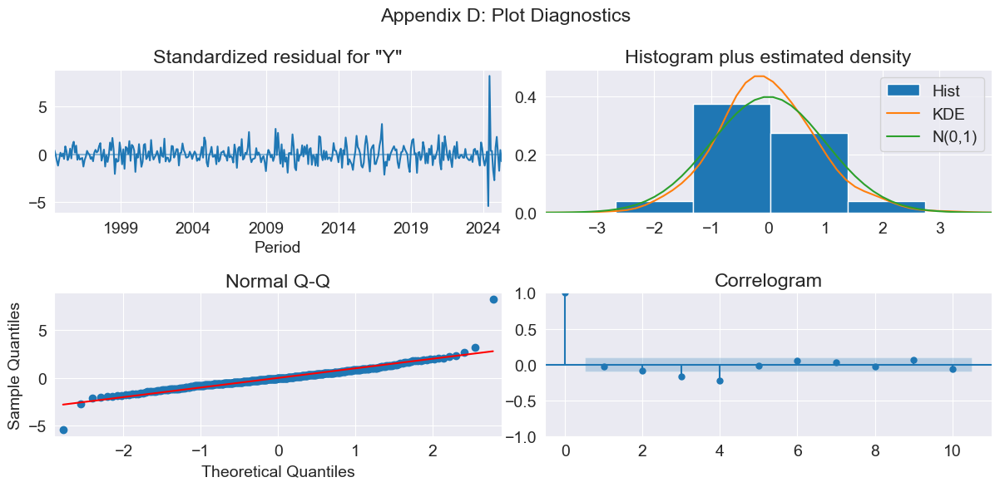

In [ ]:
results_obj = run_models({'CAR13': REG_data['CAR13']})
create_forecast_report(results_obj['best'])
# create_forecast_report({'car2013__var12': REG_data['CAR13']},[], varmax, log_transform = True, walkforward = False)

In [ ]:
for region in REG_data:
    results_obj = run_models({region: REG_data[region]})
    create_forecast_report(results_obj['best'], [], None, log_transform = None, walkforward = None)


  0%|          | 0/1 [00:00<?, ?it/s]

Training  arima for  R01_raw
Fitting ARIMA model for:  R01_raw


100%|██████████| 1/1 [00:00<00:00, 201.86it/s]


Training  sarimax for  R01_raw
An error occurred while training the model sarimax for:  R01_raw <class 'ValueError'>


  0%|          | 0/1 [00:00<?, ?it/s]

Training  varmax for  R01_raw


100%|██████████| 1/1 [00:00<00:00,  2.41it/s]


An error occurred while training the model varmax for:  R01_raw <class 'ValueError'>


  0%|          | 0/1 [00:00<?, ?it/s]

Training  arima for  R01_lt
Fitting ARIMA model for:  R01_lt


100%|██████████| 1/1 [00:00<00:00, 33.15it/s]


Training  sarimax for  R01_lt
An error occurred while training the model sarimax for:  R01_lt <class 'ValueError'>


  0%|          | 0/1 [00:00<?, ?it/s]

Training  varmax for  R01_lt


100%|██████████| 1/1 [00:00<00:00,  7.09it/s]


An error occurred while training the model varmax for:  R01_lt <class 'ValueError'>
Best Model for  R01  is  R01lt_arima_results
  Country  Model                      Params Log Transform  RMSE Naive RMSE  \
0     R01  ARIMA  [(2, 0, 1), (2, 0, 0, 12)]          True  2.28       0.12   
1     R01  ARIMA  [(1, 1, 1), (2, 0, 0, 12)]         False  5.98       0.12   

     MAPE Naive MAPE          Results Set  
0    67.8       2.92  R01lt_arima_results  
1  173.42       2.91     R01arima_results  


  0%|          | 0/1 [00:00<?, ?it/s]

Training  arima for  R02_raw


100%|██████████| 1/1 [00:00<00:00,  2.48it/s]


An error occurred while training the model arima for:  R02_raw <class 'KeyboardInterrupt'>


100%|██████████| 1/1 [00:00<00:00, 131.86it/s]

Training  sarimax for  R02_raw
An error occurred while training the model sarimax for:  R02_raw <class 'ValueError'>



  0%|          | 0/1 [00:00<?, ?it/s]

Training  varmax for  R02_raw


100%|██████████| 1/1 [00:00<00:00,  4.37it/s]


An error occurred while training the model varmax for:  R02_raw <class 'ValueError'>


  0%|          | 0/1 [00:00<?, ?it/s]

Training  arima for  R02_lt
Fitting ARIMA model for:  R02_lt


100%|██████████| 1/1 [00:00<00:00, 61.13it/s]


Training  sarimax for  R02_lt
An error occurred while training the model sarimax for:  R02_lt <class 'ValueError'>


100%|██████████| 1/1 [00:00<00:00, 11.35it/s]


Training  varmax for  R02_lt
An error occurred while training the model varmax for:  R02_lt <class 'ValueError'>
Best Model for  R02  is  R02lt_arima_results
  Country  Model                      Params Log Transform  RMSE Naive RMSE  \
0     R02  ARIMA  [(2, 0, 1), (2, 0, 0, 12)]          True   2.3       0.12   

    MAPE Naive MAPE          Results Set  
0  68.34       2.98  R02lt_arima_results  


  0%|          | 0/1 [00:00<?, ?it/s]

Training  arima for  R07_raw
Fitting ARIMA model for:  R07_raw


100%|██████████| 1/1 [00:00<00:00, 200.09it/s]


Training  sarimax for  R07_raw
An error occurred while training the model sarimax for:  R07_raw <class 'ValueError'>


100%|██████████| 1/1 [00:00<00:00, 10.38it/s]

Training  varmax for  R07_raw
An error occurred while training the model varmax for:  R07_raw <class 'ValueError'>



  0%|          | 0/1 [00:00<?, ?it/s]

Training  arima for  R07_lt
Fitting ARIMA model for:  R07_lt


100%|██████████| 1/1 [00:00<00:00, 77.75it/s]


Training  sarimax for  R07_lt
An error occurred while training the model sarimax for:  R07_lt <class 'ValueError'>


100%|██████████| 1/1 [00:00<00:00, 12.65it/s]


Training  varmax for  R07_lt
An error occurred while training the model varmax for:  R07_lt <class 'ValueError'>
Best Model for  R07  is  R07lt_arima_results
  Country  Model                      Params Log Transform  RMSE Naive RMSE  \
0     R07  ARIMA  [(3, 2, 0), (0, 0, 0, 12)]          True  0.70       0.82   
1     R07  ARIMA  [(0, 1, 0), (0, 0, 0, 12)]         False  0.78       0.63   

    MAPE Naive MAPE          Results Set  
0  28.38      27.39  R07lt_arima_results  
1  32.14      15.25     R07arima_results  


: 

: 

<Axes: xlabel='Period'>

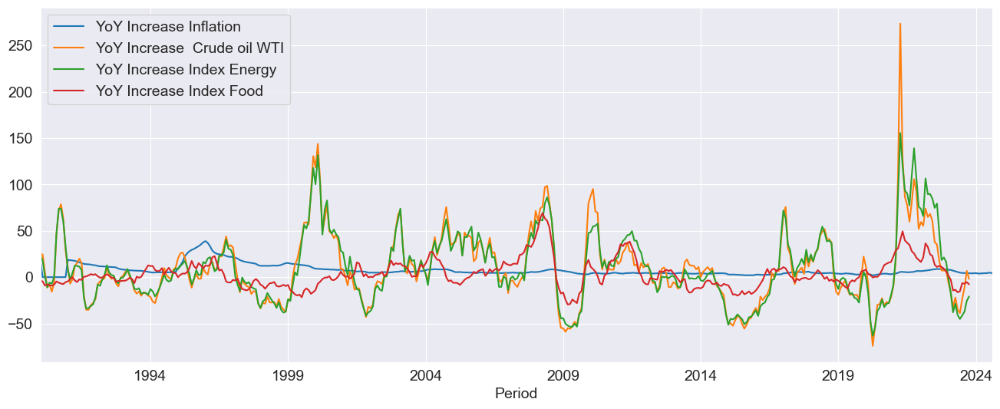

In [ ]:
REG_data['CEN10'].plot()

In [ ]:
all_data

[{'ARG':             YoY Increase Inflation  YoY Increase  Crude oil WTI  \
  Period                                                            
  2005-01-01                7.220670                    36.728044   
  2005-02-01                8.134505                    38.101444   
  2005-03-01                9.147018                    47.471436   
  2005-04-01                8.753352                    44.292368   
  2005-05-01                8.607509                    23.653493   
  ...                            ...                          ...   
  2023-12-01              210.141881                          NaN   
  2024-01-01              249.923326                          NaN   
  2024-02-01              277.086556                          NaN   
  2024-03-01              289.900770                          NaN   
  2024-04-01              292.207427                          NaN   
  
              YoY Increase Index Energy  YoY Increase Index Food  
  Period                  

In [ ]:
for data in all_data:
    create_forecast_report(data, [], arima, log_transform = False, walkforward = False)

  0%|          | 0/10 [00:00<?, ?it/s]

searching for best parameters for ARIMA model...
Training  arima for  ARG
2005-01-01      0.000000
2005-02-01     13.455090
2005-03-01      7.779499
2005-04-01     10.559335
2005-05-01      7.509181
                 ...    
2023-12-01    184.233018
2024-01-01    256.617883
2024-02-01    271.935121
2024-03-01    299.446725
2024-04-01    296.414478
Freq: MS, Name: predicted_mean, Length: 232, dtype: float64
Fitting ARIMA model for:  ARG


 10%|█         | 1/10 [01:48<16:18, 108.78s/it]

Training  arima for  BOL
Period
1990-01-01     0.000000
1991-01-01    25.006036
1991-02-01    29.409897
1991-03-01    24.454572
1991-04-01    24.713962
                ...    
2024-04-01     3.025656
2024-05-01     3.266284
2024-06-01     3.732416
2024-07-01     4.082403
2024-08-01     4.100571
Name: predicted_mean, Length: 405, dtype: float64
Fitting ARIMA model for:  BOL


 20%|██        | 2/10 [01:57<06:39, 49.93s/it] 

searching for best parameters for ARIMA model...
Training  arima for  BRA
1996-01-01     0.000000
1996-02-01    41.248259
1996-03-01    17.293041
1996-04-01    18.187400
1996-05-01    17.833029
                ...    
2024-04-01     3.416124
2024-05-01     3.759031
2024-06-01     4.415918
2024-07-01     4.346503
2024-08-01     4.538278
Freq: MS, Name: predicted_mean, Length: 344, dtype: float64
Fitting ARIMA model for:  BRA


 30%|███       | 3/10 [03:40<08:39, 74.18s/it]

searching for best parameters for ARIMA model...
Training  arima for  CHL
Period
1990-01-01     3.909812
2000-01-01    32.521442
2000-02-01    -6.845166
2000-03-01     3.576344
2000-04-01     3.482244
                ...    
2024-04-01     3.432124
2024-05-01     4.089968
2024-06-01     4.221822
2024-07-01     4.229103
2024-08-01     4.788562
Name: predicted_mean, Length: 297, dtype: float64
Fitting ARIMA model for:  CHL


 40%|████      | 4/10 [04:19<06:02, 60.45s/it]

searching for best parameters for ARIMA model...
Training  arima for  COL
Period
1990-01-01     4.927929
2000-01-01    26.325195
2000-02-01     8.193060
2000-03-01     9.095416
2000-04-01     9.931754
                ...    
2024-04-01     7.246451
2024-05-01     7.094202
2024-06-01     7.142870
2024-07-01     7.153980
2024-08-01     6.684554
Name: predicted_mean, Length: 297, dtype: float64
Fitting ARIMA model for:  COL


 50%|█████     | 5/10 [04:56<04:19, 51.91s/it]

searching for best parameters for ARIMA model...
Training  arima for  ECU
Period
1990-01-01     0.000000
1998-01-01    89.806347
1998-02-01    -9.670568
1998-03-01    42.884642
1998-04-01    32.342585
                ...    
2024-04-01     1.848520
2024-05-01     3.262689
2024-06-01     2.348529
2024-07-01     0.449991
2024-08-01     1.705633
Name: predicted_mean, Length: 321, dtype: float64
Fitting ARIMA model for:  ECU


 60%|██████    | 6/10 [1:12:57<1:34:47, 1421.87s/it]

searching for best parameters for ARIMA model...
Training  arima for  PRY
Period
1990-01-01     0.000000
1991-01-01    22.902189
1991-02-01    39.630098
1991-03-01    43.809779
1991-04-01    37.304159
                ...    
2024-04-01     3.610918
2024-05-01     4.483410
2024-06-01     4.742771
2024-07-01     4.631356
2024-08-01     4.772248
Name: predicted_mean, Length: 405, dtype: float64
Fitting ARIMA model for:  PRY


 70%|███████   | 7/10 [1:16:31<51:20, 1026.85s/it]  

searching for best parameters for ARIMA model...
Training  arima for  PER
1996-01-01     0.000000
1996-02-01    15.840077
1996-03-01    14.396208
1996-04-01    13.559617
1996-05-01    12.939537
                ...    
2024-04-01     2.883529
2024-05-01     2.314003
2024-06-01     2.492332
2024-07-01     2.333139
2024-08-01     1.846111
Freq: MS, Name: predicted_mean, Length: 344, dtype: float64
Fitting ARIMA model for:  PER


 80%|████████  | 8/10 [1:18:14<24:25, 732.77s/it] 

searching for best parameters for ARIMA model...
Training  arima for  URY
Period
1990-01-01      0.000000
1991-01-01    151.584461
1991-02-01    176.396432
1991-03-01    118.968733
1991-04-01    109.816083
                 ...    
2024-04-01      3.815980
2024-05-01      3.988543
2024-06-01      4.738792
2024-07-01      5.633134
2024-08-01      5.822701
Name: predicted_mean, Length: 405, dtype: float64
Fitting ARIMA model for:  URY


 90%|█████████ | 9/10 [1:22:15<09:38, 578.89s/it]

searching for best parameters for ARIMA model...
Training  arima for  VEN
2009-01-01    11971.066043
2009-02-01    -9800.964918
2009-03-01     3774.675155
2009-04-01      853.987783
2009-05-01      854.806206
                  ...     
2023-12-01     1061.606177
2024-01-01      930.054693
2024-02-01      877.280806
2024-03-01      890.902102
2024-04-01      891.645307
Freq: MS, Name: predicted_mean, Length: 184, dtype: float64
Fitting ARIMA model for:  VEN


  0%|          | 0/10 [00:00<?, ?it/s]

searching for best parameters for ARIMA model...
Training  arima for  CRI
Period
1990-01-01     0.000000
1996-01-01    13.152135
1996-02-01    21.257336
1996-03-01    19.483106
1996-04-01    18.156924
                ...    
2024-04-01    -0.771380
2024-05-01    -0.307161
2024-06-01     0.075534
2024-07-01     0.233128
2024-08-01     0.123885
Name: predicted_mean, Length: 345, dtype: float64
Fitting ARIMA model for:  CRI


 10%|█         | 1/10 [03:28<31:15, 208.41s/it]

searching for best parameters for ARIMA model...
Training  arima for  CUB
2001-01-01     0.000000
2001-02-01    12.291685
2001-03-01    19.864320
2001-04-01    11.704003
2001-05-01    15.650214
                ...    
2023-09-01    43.263702
2023-10-01    41.222635
2023-11-01    40.322526
2023-12-01    38.601197
2024-01-01    46.126580
Freq: MS, Name: predicted_mean, Length: 277, dtype: float64
Fitting ARIMA model for:  CUB


 20%|██        | 2/10 [04:13<15:00, 112.53s/it]

searching for best parameters for ARIMA model...
Training  arima for  SLV
1996-01-01     0.000000
1996-02-01    13.501848
1996-03-01    11.044943
1996-04-01    10.410842
1996-05-01    10.230253
                ...    
2024-04-01     0.949266
2024-05-01     1.314094
2024-06-01     1.461797
2024-07-01     1.629524
2024-08-01     1.481431
Freq: MS, Name: predicted_mean, Length: 344, dtype: float64
Fitting ARIMA model for:  SLV


 30%|███       | 3/10 [09:23<23:36, 202.38s/it]

searching for best parameters for ARIMA model...


In [ ]:
from statsmodels.tsa.stattools import adfuller

n_lags = adfuller(SUR_data['BOL'], autolag='AIC')[2]
print('Number of lags:', n_lags)

Number of lags: 15


Data shape: (405, 1)


In [ ]:

# create supervised learning samples for train and test sets individually
X_train_list, y_train_list = [], []
X_test_list, y_test_list = [], []

# train set
for i in range(n_lags, len(norm_df) - 12):
    X_train_list.append(norm_df[i - n_lags:i, 0])
    y_train_list.append(norm_df[i, 0])

# test set (last 12 months)
for i in range(len(norm_df) - 12, len(norm_df)):
    X_test_list.append(norm_df[i - n_lags:i, 0])
    y_test_list.append(norm_df[i, 0])

# convert to numpy arrays
X_train, y_train = np.array(X_train_list), np.array(y_train_list)
X_test, y_test = np.array(X_test_list), np.array(y_test_list)
# reshape input to be 3D [samples, timesteps, features]
X_train = np.reshape(X_train, (X_train.shape[0], X_train.shape[1], 1))
X_test = np.reshape(X_test, (X_test.shape[0], X_test.shape[1], 1))
print('X_train shape:', X_train.shape)
print('X_test shape:', X_test.shape)
print('y_train shape:', y_train.shape)
print('y_test shape:', y_test.shape)
# reshape y_train and y_test to 2D arrays
y_train = np.reshape(y_train, (-1, 1))
y_test = np.reshape(y_test, (-1, 1))
print('y_train shape:', y_train.shape)
print('y_test shape:', y_test.shape)


X_train shape: (378, 15, 1)
X_test shape: (12, 15, 1)
y_train shape: (378,)
y_test shape: (12,)
y_train shape: (378, 1)
y_test shape: (12, 1)


In [ ]:
cnn_history = cnn.fit(
    x=X_train,
    y=y_train,
    epochs=200,
    batch_size=10,
    verbose=0,
    validation_data=(X_test, y_test),
    callbacks=None
)


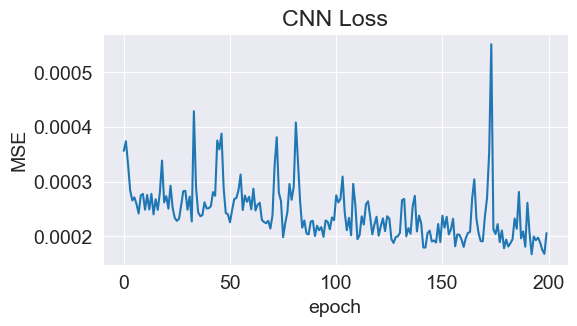

In [ ]:
# plot learning process
plt.figure(figsize=(6, 3))

plt.plot(range(200), cnn_history.history['loss'])
plt.title('CNN Loss')
plt.xlabel('epoch')
plt.ylabel('MSE')

plt.show()

In [ ]:
# make predictions and rescale back from [0, 1] to original
cnn_predictions = cnn.predict(X)
cnn_pred = scaler.inverse_transform(cnn_predictions)

# true inflation rates
true = SUR_data['BOL'].iloc[n_lags:]

13/13 [==============================] - 0s 1ms/step


In [ ]:
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.metrics import mean_absolute_error, mean_absolute_percentage_error

rmse = np.sqrt(mean_squared_error(true, cnn_pred))
r2 = r2_score(true, cnn_pred)
mae = mean_absolute_error(true, cnn_pred)
mape = mean_absolute_percentage_error(true, cnn_pred)

print('CNN performance:')
print('----------------')
print('RMSE: {:.4f}'.format(rmse))
print('R2: {:.4f}'.format(r2))
print('MAE: {:.4f}'.format(mae))
print('MAPE: {:.4f}%'.format(mape))

CNN performance:
----------------
RMSE: 0.3498
R2: 0.9911
MAE: 0.2557
MAPE: 0.1123%


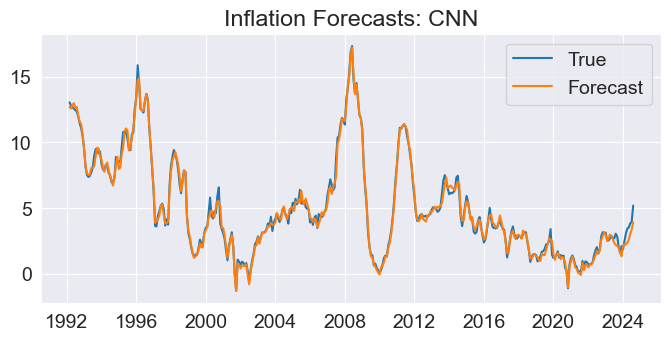

In [ ]:
plt.figure(figsize=(8, 3.5))

plt.plot(true.index, true.values, label='True')
plt.plot(true.index, cnn_pred, label='Forecast')
plt.title('Inflation Forecasts: CNN')
plt.legend()

plt.show()


In [ ]:
#print test set predictions 
cnn_pred_test = cnn_pred[-12:]
print('CNN predictions:')
 #calculate metrics vs true 
print('----------------')
print('RMSE: {:.4f}'.format(np.sqrt(mean_squared_error(true[-12:], cnn_pred_test))))
print('R2: {:.4f}'.format(r2_score(true[-12:], cnn_pred_test)))
print('MAE: {:.4f}'.format(mean_absolute_error(true[-12:], cnn_pred_test)))
print('MAPE: {:.4f}%'.format(mean_absolute_percentage_error(true[-12:], cnn_pred_test) * 100))
print('Predictions:')
print(cnn_pred_test)
print('True values:')
print(true[-12:])



CNN predictions:
----------------
RMSE: 0.7389
R2: 0.4582
MAE: 0.6312
MAPE: 19.5472%
Predictions:
[[2.134035 ]
 [2.0123446]
 [1.6136084]
 [1.3417407]
 [2.1275885]
 [2.2655017]
 [2.2252762]
 [2.3951392]
 [2.5999227]
 [3.0598543]
 [3.358505 ]
 [3.9116447]]
True values:
            YoY Increase Inflation
Period                            
2023-09-01                2.847826
2023-10-01                2.075432
2023-11-01                1.594145
2023-12-01                2.118325
2024-01-01                1.863148
2024-02-01                2.516604
2024-03-01                3.061649
2024-04-01                3.460330
2024-05-01                3.518113
2024-06-01                3.848888
2024-07-01                3.950064
2024-08-01                5.197109


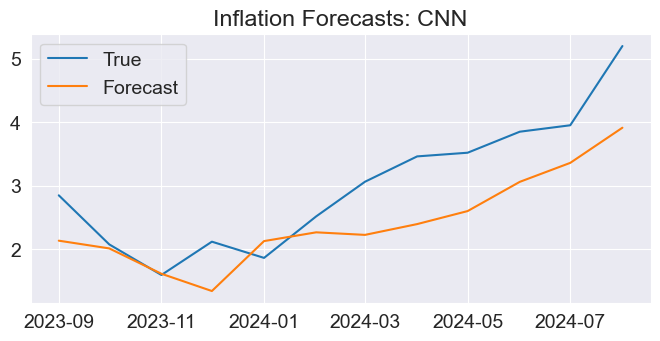

In [ ]:
#plot test set predictions vs true values
plt.figure(figsize=(8, 3.5))
plt.plot(true.index[-12:], true.values[-12:], label='True')
plt.plot(true.index[-12:], cnn_pred_test, label='Forecast')
plt.title('Inflation Forecasts: CNN')
plt.legend()
plt.show()



In [ ]:
# number of time steps (months) to forecast ahead
forecast_period = 12
forecast = []
last_sequence = X[-1]

# get out-of samples
for _ in range(forecast_period):
    last_sequence = last_sequence.reshape((1, n_lags, 1)) # reshape last_sequence for prediction
    
    next_pred = cnn.predict(last_sequence) # predict the next value
    
    forecast.append(next_pred[0, 0]) # append the predicted value to list
    
    # update last_sequence with the new value
    last_sequence = np.append(last_sequence[:, 1:, :], next_pred[0, 0]).reshape((1, n_lags, 1))

cnn_forecast = scaler.inverse_transform(np.array(forecast).reshape(-1, 1))

1/1 [==============================] - 0s 22ms/step


In [ ]:
cnn_forecast

array([[3.9116447],
       [4.044887 ],
       [4.6918206],
       [4.589659 ],
       [4.4487467],
       [4.3250017],
       [4.104518 ],
       [4.2656555],
       [4.345182 ],
       [4.353285 ],
       [4.1363792],
       [4.1015296]], dtype=float32)

1/1 [==============================] - 0s 209ms/step
CNN RMSE: 0.6790
CNN MAPE: 16.8196%
Naive RMSE: 0.0222
Naive MAPE: 11.8777%
Performing stepwise search to minimize aic
 ARIMA(2,1,2)(0,0,0)[0] intercept   : AIC=1003.264, Time=0.26 sec
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=1041.379, Time=0.12 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=997.503, Time=0.09 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=1004.028, Time=0.09 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=1039.997, Time=0.03 sec
 ARIMA(2,1,0)(0,0,0)[0] intercept   : AIC=999.275, Time=0.12 sec
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=999.265, Time=0.24 sec
 ARIMA(2,1,1)(0,0,0)[0] intercept   : AIC=1001.250, Time=0.13 sec
 ARIMA(1,1,0)(0,0,0)[0]             : AIC=995.659, Time=0.04 sec
 ARIMA(2,1,0)(0,0,0)[0]             : AIC=997.414, Time=0.06 sec
 ARIMA(1,1,1)(0,0,0)[0]             : AIC=997.403, Time=0.09 sec
 ARIMA(0,1,1)(0,0,0)[0]             : AIC=1002.318, Time=0.08 sec
 ARIMA(2,1,1)(0,0,0)[0]             : AIC=

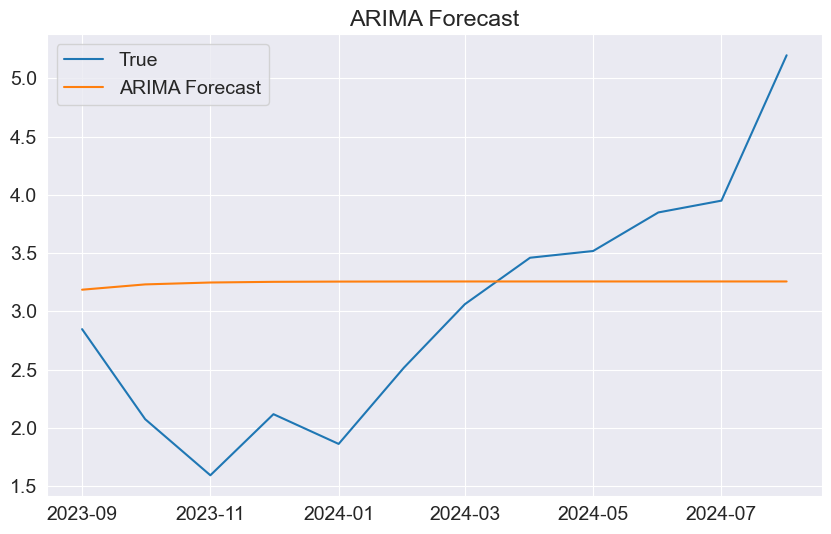

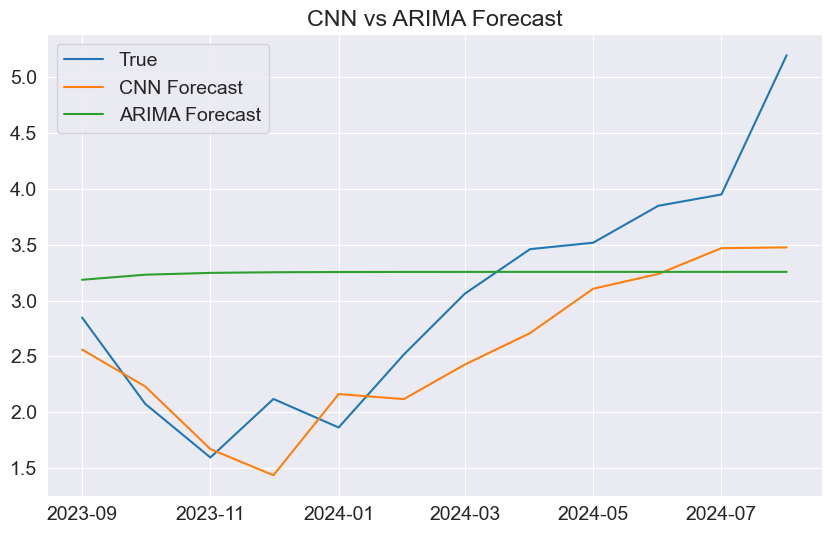

In [ ]:
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Conv1D, Flatten
from sklearn.metrics import mean_squared_error, mean_absolute_percentage_error

# Use already defined norm_df, train_data, test_data, n_lags
#define norm_df 
raw_data = SUR_data['BOL']

# Normalize the data
from sklearn.preprocessing import MinMaxScaler
scaler = MinMaxScaler(feature_range=(0, 1))
norm_data = scaler.fit_transform(raw_data['YoY Increase Inflation'].values.reshape(-1, 1))
# Convert to DataFrame for easier manipulation
norm_data = pd.DataFrame(norm_data, columns=['YoY Increase Inflation'], index=raw_data.index)
# Define the number of lags

#use adf uller to determine the number of lags
from statsmodels.tsa.stattools import adfuller
n_lags = adfuller(norm_data['YoY Increase Inflation'], autolag='AIC')[2]
# Define the train size, everything but last 12 months
train_size = len(norm_data) - 12


import numpy as np

# Prepare supervised learning samples from the full normalized data before splitting
all_values = norm_data['YoY Increase Inflation'].values
X_all, y_all = [], []
for i in range(n_lags, len(all_values)):
    X_all.append(all_values[i - n_lags:i])
    y_all.append(all_values[i])

X_all, y_all = np.array(X_all), np.array(y_all)


# Split into train and test sets using train_size
X_train, y_train = X_all[:train_size - n_lags], y_all[:train_size - n_lags]
X_test, y_test = X_all[train_size - n_lags:], y_all[train_size - n_lags:]

#train and test data for arima 
train_data = raw_data['YoY Increase Inflation'][:train_size]
test_data = raw_data['YoY Increase Inflation'][train_size:]

# Reshape for CNN input
X_train = X_train.reshape((X_train.shape[0], X_train.shape[1], 1))
X_test = X_test.reshape((X_test.shape[0], X_test.shape[1], 1))
y_train = y_train.reshape((-1, 1))
y_test = y_test.reshape((-1, 1))

# Build and train CNN model
model = Sequential()
model.add(Conv1D(filters=64, kernel_size=2, activation='relu', input_shape=(n_lags, 1)))
model.add(Flatten())
model.add(Dense(50, activation='relu'))
model.add(Dense(1))
model.compile(optimizer='adam', loss='mean_squared_error')
model.fit(X_train, y_train, epochs=200, verbose=0)

# Predict on test set
cnn_pred = model.predict(X_test)

# Rescale predictions back to original scale
cnn_pred = scaler.inverse_transform(cnn_pred)
# Rescale y_test back to original scale
y_test = scaler.inverse_transform(y_test)


# Calculate metrics
if len(y_test) > 0:
    rmse_cnn = np.sqrt(mean_squared_error(y_test, cnn_pred))
    mape_cnn = mean_absolute_percentage_error(y_test, cnn_pred) * 100
    print(f"CNN RMSE: {rmse_cnn:.4f}")
    print(f"CNN MAPE: {mape_cnn:.4f}%")
else:
    print("Test set too small for supervised evaluation with current n_lags.")

# Naive forecast (previous value)
if len(test_values) > 1:
    naive_forecast_previous_value = test_values[:-1]
    rmse_naive = np.sqrt(mean_squared_error(test_values[1:], naive_forecast_previous_value))
    mape_naive = mean_absolute_percentage_error(test_values[1:], naive_forecast_previous_value) * 100
    print(f"Naive RMSE: {rmse_naive:.4f}")
    print(f"Naive MAPE: {mape_naive:.4f}%")
else:
    print("Test set too small for naive forecast evaluation.")

#do pmd arima for baseline and compare to CNN
from pmdarima import auto_arima
# Fit the model
# Use auto_arima to find the best ARIMA model based on AIC/BIC
#ARIMA - [(1, 1, 2), (0, 0, 2, 12)]

#run arima with (1,1,2) (0,0,2,12)
model = auto_arima(train_data, seasonal=True, stepwise=True, trace=True)
# Fit the model
model_fit = model.fit(train_data)



#forecast the next 12 months
# The reason auto_arima may only predict 10 steps instead of 12 is usually due to the length of your test_data index.
# If test_data only has 10 periods, model_fit.predict(steps=12) will still return 12 values, but plotting against test_data.index will only show 10 points.
# To ensure you get 12 forecasted values and plot them correctly, generate a new index for the forecast if needed:

arima_forecast = model_fit.predict(n_periods=12)

# If you want to plot the forecast for the next 12 periods, create a new index:
if len(test_data.index) < 12:
    # Extend the index for plotting
    last_period = test_data.index[-1]
    freq = test_data.index.freq or pd.infer_freq(test_data.index)
    forecast_index = pd.period_range(start=last_period + 1, periods=12, freq=freq)
else:
    forecast_index = test_data.index

# Now you can plot arima_forecast against forecast_index
rmse_arima = np.sqrt(mean_squared_error(test_data, arima_forecast))
mape_arima = mean_absolute_percentage_error(test_data, arima_forecast) * 100
print(f"ARIMA RMSE: {rmse_arima:.4f}")
print(f"ARIMA MAPE: {mape_arima:.4f}%")
# Plot the results
plt.figure(figsize=(10, 6))
plt.plot(test_data.index, test_data, label='True')
plt.plot(test_data.index, arima_forecast, label='ARIMA Forecast')
plt.title('ARIMA Forecast')
plt.legend()
plt.show()
#plot all models
plt.figure(figsize=(10, 6))
plt.plot(test_data.index, test_data, label='True')
plt.plot(test_data.index, cnn_pred, label='CNN Forecast')
plt.plot(test_data.index, arima_forecast, label='ARIMA Forecast')
plt.title('CNN vs ARIMA Forecast')
plt.legend()
plt.show()





In [ ]:
from keras.layers import LSTM

# define LSTM model
lstm = Sequential()
lstm.add(LSTM(units=64, return_sequences=True, input_shape=(X.shape[1], X.shape[2])))
lstm.add(LSTM(units=64, return_sequences=False))
lstm.add(Dense(32))
lstm.add(Dense(1))
lstm.compile(optimizer='adam', loss='mean_squared_error')

lstm_history = lstm.fit(
    x=X,
    y=y,
    epochs=60,
    batch_size=10,
    verbose=0,
    callbacks=None
)

In [ ]:
#compare models 
model_compare(REG_data, [arima, cnn_model, sarimax,varmax], log_transform=False, walkforward=False)

NameError: name 'model_compare' is not defined